<a href="https://colab.research.google.com/github/xiaoyufan/speech-data-augmentation/blob/main/MelGAN_VC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#We'll be using TF 2.1 and torchaudio

try:
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
!pip install soundfile                    #to save wav files
!pip install --no-deps torchaudio==0.5.0

     |████████████████████████████████| 3.2MB 14.5MB/s 


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Connecting Drive to save model checkpoints during training and to use custom data, uncomment if needed

# import os
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
# #Dataset download (Uncomment where needed)

# #Arctic dataset for voice conversion
!wget --header="Host: festvox.org" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.100 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://festvox.org/cmu_arctic/cmu_arctic/packed/" "http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_bdl_arctic-0.95-release.zip" -O "cmu_us_bdl_arctic-0.95-release.zip" -c
!unzip -qq cmu_us_bdl_arctic-0.95-release.zip #MALE1
!wget --header="Host: festvox.org" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.100 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://festvox.org/cmu_arctic/cmu_arctic/packed/" "http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_clb_arctic-0.95-release.zip" -O "cmu_us_clb_arctic-0.95-release.zip" -c
!unzip -qq cmu_us_clb_arctic-0.95-release.zip #FEMALE1
!wget --header="Host: festvox.org" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.100 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://festvox.org/cmu_arctic/cmu_arctic/packed/" "http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_rms_arctic-0.95-release.zip" -O "cmu_us_rms_arctic-0.95-release.zip" -c
!unzip -qq cmu_us_rms_arctic-0.95-release.zip #MALE2
!wget --header="Host: festvox.org" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.100 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://festvox.org/cmu_arctic/cmu_arctic/packed/" "http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_slt_arctic-0.95-release.zip" -O "cmu_us_slt_arctic-0.95-release.zip" -c
!unzip -qq cmu_us_slt_arctic-0.95-release.zip #FEMALE2

# #GTZAN dataset for music genre transfer
# # !wget --header="Host: opihi.cs.uvic.ca" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/77.0.3865.90 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3" --header="Accept-Language: it-IT,it;q=0.9,en-US;q=0.8,en;q=0.7" --header="Referer: http://marsyas.info/downloads/datasets.html" "http://opihi.cs.uvic.ca/sound/genres.tar.gz" -O "genres.tar.gz" -c
# # !tar -xzf genres.tar.gz

!ls

--2020-12-15 02:36:47--  http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_bdl_arctic-0.95-release.zip
Resolving festvox.org (festvox.org)... 199.4.150.154
Connecting to festvox.org (festvox.org)|199.4.150.154|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 108711968 (104M) [application/zip]
Saving to: ‘cmu_us_bdl_arctic-0.95-release.zip’

cmu_us_bdl_arctic-0 100%[===================>] 103.68M  1.93MB/s    in 39s     

2020-12-15 02:37:28 (2.63 MB/s) - ‘cmu_us_bdl_arctic-0.95-release.zip’ saved [108711968/108711968]

--2020-12-15 02:37:30--  http://festvox.org/cmu_arctic/cmu_arctic/packed/cmu_us_clb_arctic-0.95-release.zip
Resolving festvox.org (festvox.org)... 199.4.150.154
Connecting to festvox.org (festvox.org)|199.4.150.154|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 148300802 (141M) [application/zip]
Saving to: ‘cmu_us_clb_arctic-0.95-release.zip’

cmu_us_clb_arctic-0 100%[===================>] 141.43M  3.40MB/s    in 58s 

In [ ]:
#Imports

from __future__ import print_function, division
from glob import glob
import scipy
import soundfile as sf
import matplotlib.pyplot as plt
from IPython.display import clear_output
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Concatenate, Conv2D, Conv2DTranspose, GlobalAveragePooling2D, UpSampling2D, LeakyReLU, ReLU, Add, Multiply, Lambda, Dot, BatchNormalization, Activation, ZeroPadding2D, Cropping2D, Cropping1D
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.initializers import TruncatedNormal, he_normal
import tensorflow.keras.backend as K
import datetime
import numpy as np
import random
import matplotlib.pyplot as plt
import collections
from PIL import Image
from skimage.transform import resize
import imageio
import librosa
import librosa.display
from librosa.feature import melspectrogram
import os
import time
import IPython

In [ ]:
#Hyperparameters

hop=192               #hop size (window size = 6*hop)
sr=16000              #sampling rate
min_level_db=-100     #reference values to normalize data
ref_level_db=20

shape=24              #length of time axis of split specrograms to feed to generator            
vec_len=128           #length of vector generated by siamese vector
bs = 16               #batch size
delta = 2.            #constant for siamese loss

In [ ]:
#There seems to be a problem with Tensorflow STFT, so we'll be using pytorch to handle offline mel-spectrogram generation and waveform reconstruction
#For waveform reconstruction, a gradient-based method is used:

''' Decorsière, Rémi, Peter L. Søndergaard, Ewen N. MacDonald, and Torsten Dau. 
"Inversion of auditory spectrograms, traditional spectrograms, and other envelope representations." 
IEEE/ACM Transactions on Audio, Speech, and Language Processing 23, no. 1 (2014): 46-56.'''

#ORIGINAL CODE FROM https://github.com/yoyololicon/spectrogram-inversion

import torch
import torch.nn as nn
import torch.nn.functional as F
from tqdm import tqdm
from functools import partial
import math
import heapq
from torchaudio.transforms import MelScale, Spectrogram

torch.set_default_tensor_type('torch.cuda.FloatTensor')

specobj = Spectrogram(n_fft=6*hop, win_length=6*hop, hop_length=hop, pad=0, power=2, normalized=True)
specfunc = specobj.forward
melobj = MelScale(n_mels=hop, sample_rate=sr, f_min=0.)
melfunc = melobj.forward

def melspecfunc(waveform):
  specgram = specfunc(waveform)
  mel_specgram = melfunc(specgram)
  return mel_specgram

def spectral_convergence(input, target):
    return 20 * ((input - target).norm().log10() - target.norm().log10())

def GRAD(spec, transform_fn, samples=None, init_x0=None, maxiter=1000, tol=1e-6, verbose=1, evaiter=10, lr=0.003):

    spec = torch.Tensor(spec)
    samples = (spec.shape[-1]*hop)-hop

    if init_x0 is None:
        init_x0 = spec.new_empty((1,samples)).normal_(std=1e-6)
    x = nn.Parameter(init_x0)
    T = spec

    criterion = nn.L1Loss()
    optimizer = torch.optim.Adam([x], lr=lr)

    bar_dict = {}
    metric_func = spectral_convergence
    bar_dict['spectral_convergence'] = 0
    metric = 'spectral_convergence'

    init_loss = None
    with tqdm(total=maxiter, disable=not verbose) as pbar:
        for i in range(maxiter):
            optimizer.zero_grad()
            V = transform_fn(x)
            loss = criterion(V, T)
            loss.backward()
            optimizer.step()
            lr = lr*0.9999
            for param_group in optimizer.param_groups:
              param_group['lr'] = lr

            if i % evaiter == evaiter - 1:
                with torch.no_grad():
                    V = transform_fn(x)
                    bar_dict[metric] = metric_func(V, spec).item()
                    l2_loss = criterion(V, spec).item()
                    pbar.set_postfix(**bar_dict, loss=l2_loss)
                    pbar.update(evaiter)

    return x.detach().view(-1).cpu()

def normalize(S):
  return np.clip((((S - min_level_db) / -min_level_db)*2.)-1., -1, 1)

def denormalize(S):
  return (((np.clip(S, -1, 1)+1.)/2.) * -min_level_db) + min_level_db

def prep(wv,hop=192):
  S = np.array(torch.squeeze(melspecfunc(torch.Tensor(wv).view(1,-1))).detach().cpu())
  S = librosa.power_to_db(S)-ref_level_db
  return normalize(S)

def deprep(S):
  S = denormalize(S)+ref_level_db
  S = librosa.db_to_power(S)
  wv = GRAD(np.expand_dims(S,0), melspecfunc, maxiter=2000, evaiter=10, tol=1e-8)
  return np.array(np.squeeze(wv))

In [ ]:
#Helper functions

#Generate spectrograms from waveform array
def tospec(data):
  specs=np.empty(data.shape[0], dtype=object)
  for i in range(data.shape[0]):
    x = data[i]
    S=prep(x)
    S = np.array(S, dtype=np.float32)
    specs[i]=np.expand_dims(S, -1)
  print(specs.shape)
  return specs

#Generate multiple spectrograms with a determined length from single wav file
def tospeclong(path, length=4*16000):
  x, sr = librosa.load(path,sr=16000)
  x,_ = librosa.effects.trim(x)
  loudls = librosa.effects.split(x, top_db=50)
  xls = np.array([])
  for interv in loudls:
    xls = np.concatenate((xls,x[interv[0]:interv[1]]))
  x = xls
  num = x.shape[0]//length
  specs=np.empty(num, dtype=object)
  for i in range(num-1):
    a = x[i*length:(i+1)*length]
    S = prep(a)
    S = np.array(S, dtype=np.float32)
    try:
      sh = S.shape
      specs[i]=S
    except AttributeError:
      print('spectrogram failed')
  print(specs.shape)
  return specs

#Waveform array from path of folder containing wav files
def audio_array(path):
  ls = glob(f'{path}/*.wav')
  adata = []
  for i in range(len(ls)):
    #print(ls[i])
    x, sr = tf.audio.decode_wav(tf.io.read_file(ls[i]), 1)
    x = np.array(x, dtype=np.float32)
    adata.append(x)
  return np.array(adata)

#Concatenate spectrograms in array along the time axis
def testass(a):
  but=False
  con = np.array([])
  nim = a.shape[0]
  for i in range(nim):
    im = a[i]
    im = np.squeeze(im)
    if not but:
      con=im
      but=True
    else:
      con = np.concatenate((con,im), axis=1)
  return np.squeeze(con)

#Split spectrograms in chunks with equal size
def splitcut(data):
  ls = []
  mini = 0
  minifinal = 10*shape                                                              #max spectrogram length
  for i in range(data.shape[0]-1):
    if data[i].shape[1]<=data[i+1].shape[1]:
      mini = data[i].shape[1]
    else:
      mini = data[i+1].shape[1]
    if mini>=3*shape and mini<minifinal:
      minifinal = mini
  for i in range(data.shape[0]):
    x = data[i]
    if x.shape[1]>=3*shape:
      for n in range(x.shape[1]//minifinal):
        ls.append(x[:,n*minifinal:n*minifinal+minifinal,:])
      ls.append(x[:,-minifinal:,:])
  return np.array(ls)

In [ ]:
#Generating Mel-Spectrogram dataset (Uncomment where needed)
#adata: source spectrograms
#bdata: target spectrograms
# purpose change male to female
#MALE1
awv = audio_array('/content/drive/MyDrive/nlp-project/male_160')                               #get waveform array from folder containing wav files
aspec = tospec(awv)                                                                 #get spectrogram array
adata = splitcut(aspec)                                                             #split spectrogams to fixed length
#FEMALE1
bwv = audio_array('/content/drive/MyDrive/nlp-project/female _160')
bspec = tospec(bwv)
bdata = splitcut(bspec)
# #MALE2
# awv = audio_array('../content/cmu_us_rms_arctic/wav')
# aspec = tospec(awv)
# adata = splitcut(aspec)
# #FEMALE2
# bwv = audio_array('../content/cmu_us_slt_arctic/wav')
# bspec = tospec(bwv)
# bdata = splitcut(bspec)

#JAZZ MUSIC
# awv = audio_array('../content/genres/jazz')
# aspec = tospec(awv)
# adata = splitcut(aspec)
#CLASSICAL MUSIC
# bwv = audio_array('../content/genres/classical')
# bspec = tospec(bwv)
# bdata = splitcut(bspec)

/usr/local/lib/python3.6/dist-packages/torch/functional.py:516: UserWarning: stft will require the return_complex parameter be explicitly  specified in a future PyTorch release. Use return_complex=False  to preserve the current behavior or return_complex=True to return  a complex output. (Triggered internally at  /pytorch/aten/src/ATen/native/SpectralOps.cpp:653.)
  normalized, onesided, return_complex)
/usr/local/lib/python3.6/dist-packages/torch/functional.py:516: UserWarning: The function torch.rfft is deprecated and will be removed in a future PyTorch release. Use the new torch.fft module functions, instead, by importing torch.fft and calling torch.fft.fft or torch.fft.rfft. (Triggered internally at  /pytorch/aten/src/ATen/native/SpectralOps.cpp:590.)
  normalized, onesided, return_complex)


(160,)
(160,)


In [ ]:
#Creating Tensorflow Datasets

@tf.function
def proc(x):
  return tf.image.random_crop(x, size=[hop, 3*shape, 1])

dsa = tf.data.Dataset.from_tensor_slices(adata).repeat(50).map(proc, num_parallel_calls=tf.data.experimental.AUTOTUNE).shuffle(10000).batch(bs, drop_remainder=True)
dsb = tf.data.Dataset.from_tensor_slices(bdata).repeat(50).map(proc, num_parallel_calls=tf.data.experimental.AUTOTUNE).shuffle(10000).batch(bs, drop_remainder=True)

In [ ]:
#Adding Spectral Normalization to convolutional layers

from tensorflow.python.keras.utils import conv_utils
from tensorflow.python.ops import array_ops
from tensorflow.python.ops import math_ops
from tensorflow.python.ops import sparse_ops
from tensorflow.python.ops import gen_math_ops
from tensorflow.python.ops import standard_ops
from tensorflow.python.eager import context
from tensorflow.python.framework import tensor_shape

def l2normalize(v, eps=1e-12):
    return v / (tf.norm(v) + eps)


class ConvSN2D(tf.keras.layers.Conv2D):

    def __init__(self, filters, kernel_size, power_iterations=1, **kwargs):
        super(ConvSN2D, self).__init__(filters, kernel_size, **kwargs)
        self.power_iterations = power_iterations


    def build(self, input_shape):
        super(ConvSN2D, self).build(input_shape)

        if self.data_format == 'channels_first':
            channel_axis = 1
        else:
            channel_axis = -1

        self.u = self.add_weight(self.name + '_u',
            shape=tuple([1, self.kernel.shape.as_list()[-1]]), 
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False
        )

    def compute_spectral_norm(self, W, new_u, W_shape):
        for _ in range(self.power_iterations):

            new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
            new_u = l2normalize(tf.matmul(new_v, W))
            
        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W/sigma

        with tf.control_dependencies([self.u.assign(new_u)]):
          W_bar = tf.reshape(W_bar, W_shape)

        return W_bar


    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)
        outputs = self._convolution_op(inputs, new_kernel)

        if self.use_bias:
            if self.data_format == 'channels_first':
                    outputs = tf.nn.bias_add(outputs, self.bias, data_format='NCHW')
            else:
                outputs = tf.nn.bias_add(outputs, self.bias, data_format='NHWC')
        if self.activation is not None:
            return self.activation(outputs)

        return outputs

class ConvSN2DTranspose(tf.keras.layers.Conv2DTranspose):

    def __init__(self, filters, kernel_size, power_iterations=1, **kwargs):
        super(ConvSN2DTranspose, self).__init__(filters, kernel_size, **kwargs)
        self.power_iterations = power_iterations


    def build(self, input_shape):
        super(ConvSN2DTranspose, self).build(input_shape)

        if self.data_format == 'channels_first':
            channel_axis = 1
        else:
            channel_axis = -1

        self.u = self.add_weight(self.name + '_u',
            shape=tuple([1, self.kernel.shape.as_list()[-1]]), 
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False
        )

    def compute_spectral_norm(self, W, new_u, W_shape):
        for _ in range(self.power_iterations):

            new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
            new_u = l2normalize(tf.matmul(new_v, W))
            
        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W/sigma

        with tf.control_dependencies([self.u.assign(new_u)]):
          W_bar = tf.reshape(W_bar, W_shape)

        return W_bar

    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)

        inputs_shape = array_ops.shape(inputs)
        batch_size = inputs_shape[0]
        if self.data_format == 'channels_first':
          h_axis, w_axis = 2, 3
        else:
          h_axis, w_axis = 1, 2

        height, width = inputs_shape[h_axis], inputs_shape[w_axis]
        kernel_h, kernel_w = self.kernel_size
        stride_h, stride_w = self.strides

        if self.output_padding is None:
          out_pad_h = out_pad_w = None
        else:
          out_pad_h, out_pad_w = self.output_padding

        out_height = conv_utils.deconv_output_length(height,
                                                    kernel_h,
                                                    padding=self.padding,
                                                    output_padding=out_pad_h,
                                                    stride=stride_h,
                                                    dilation=self.dilation_rate[0])
        out_width = conv_utils.deconv_output_length(width,
                                                    kernel_w,
                                                    padding=self.padding,
                                                    output_padding=out_pad_w,
                                                    stride=stride_w,
                                                    dilation=self.dilation_rate[1])
        if self.data_format == 'channels_first':
          output_shape = (batch_size, self.filters, out_height, out_width)
        else:
          output_shape = (batch_size, out_height, out_width, self.filters)

        output_shape_tensor = array_ops.stack(output_shape)
        outputs = K.conv2d_transpose(
            inputs,
            new_kernel,
            output_shape_tensor,
            strides=self.strides,
            padding=self.padding,
            data_format=self.data_format,
            dilation_rate=self.dilation_rate)

        if not context.executing_eagerly():
          out_shape = self.compute_output_shape(inputs.shape)
          outputs.set_shape(out_shape)

        if self.use_bias:
          outputs = tf.nn.bias_add(
              outputs,
              self.bias,
              data_format=conv_utils.convert_data_format(self.data_format, ndim=4))

        if self.activation is not None:
          return self.activation(outputs)
        return outputs  

class DenseSN(Dense):
    def build(self, input_shape):
        super(DenseSN, self).build(input_shape)

        self.u = self.add_weight(self.name + '_u',
            shape=tuple([1, self.kernel.shape.as_list()[-1]]), 
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False)
        
    def compute_spectral_norm(self, W, new_u, W_shape):
        new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
        new_u = l2normalize(tf.matmul(new_v, W))
        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W/sigma
        with tf.control_dependencies([self.u.assign(new_u)]):
          W_bar = tf.reshape(W_bar, W_shape)
        return W_bar
        
    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)
        rank = len(inputs.shape)
        if rank > 2:
          outputs = standard_ops.tensordot(inputs, new_kernel, [[rank - 1], [0]])
          if not context.executing_eagerly():
            shape = inputs.shape.as_list()
            output_shape = shape[:-1] + [self.units]
            outputs.set_shape(output_shape)
        else:
          inputs = math_ops.cast(inputs, self._compute_dtype)
          if K.is_sparse(inputs):
            outputs = sparse_ops.sparse_tensor_dense_matmul(inputs, new_kernel)
          else:
            outputs = gen_math_ops.mat_mul(inputs, new_kernel)
        if self.use_bias:
          outputs = tf.nn.bias_add(outputs, self.bias)
        if self.activation is not None:
          return self.activation(outputs)
        return outputs


In [ ]:
#Networks Architecture

init = tf.keras.initializers.he_uniform()

def conv2d(layer_input, filters, kernel_size=4, strides=2, padding='same', leaky=True, bnorm=True, sn=True):
  if leaky:
    Activ = LeakyReLU(alpha=0.2)
  else:
    Activ = ReLU()
  if sn:
    d = ConvSN2D(filters, kernel_size=kernel_size, strides=strides, padding=padding, kernel_initializer=init, use_bias=False)(layer_input)
  else:
    d = Conv2D(filters, kernel_size=kernel_size, strides=strides, padding=padding, kernel_initializer=init, use_bias=False)(layer_input)
  if bnorm:
    d = BatchNormalization()(d)
  d = Activ(d)
  return d

def deconv2d(layer_input, layer_res, filters, kernel_size=4, conc=True, scalev=False, bnorm=True, up=True, padding='same', strides=2):
  if up:
    u = UpSampling2D((1,2))(layer_input)
    u = ConvSN2D(filters, kernel_size, strides=(1,1), kernel_initializer=init, use_bias=False, padding=padding)(u)
  else:
    u = ConvSN2DTranspose(filters, kernel_size, strides=strides, kernel_initializer=init, use_bias=False, padding=padding)(layer_input)
  if bnorm:
    u = BatchNormalization()(u)
  u = LeakyReLU(alpha=0.2)(u)
  if conc:
    u = Concatenate()([u,layer_res])
  return u

#Extract function: splitting spectrograms
def extract_image(im):
  im1 = Cropping2D(((0,0), (0, 2*(im.shape[2]//3))))(im)
  im2 = Cropping2D(((0,0), (im.shape[2]//3,im.shape[2]//3)))(im)
  im3 = Cropping2D(((0,0), (2*(im.shape[2]//3), 0)))(im)
  return im1,im2,im3

#Assemble function: concatenating spectrograms
def assemble_image(lsim):
  im1,im2,im3 = lsim
  imh = Concatenate(2)([im1,im2,im3])
  return imh

#U-NET style architecture
def build_generator(input_shape):
  h,w,c = input_shape
  inp = Input(shape=input_shape)
  #downscaling
  g0 = tf.keras.layers.ZeroPadding2D((0,1))(inp)
  g1 = conv2d(g0, 256, kernel_size=(h,3), strides=1, padding='valid')
  g2 = conv2d(g1, 256, kernel_size=(1,9), strides=(1,2))
  g3 = conv2d(g2, 256, kernel_size=(1,7), strides=(1,2))
  #upscaling
  g4 = deconv2d(g3,g2, 256, kernel_size=(1,7), strides=(1,2))
  g5 = deconv2d(g4,g1, 256, kernel_size=(1,9), strides=(1,2), bnorm=False)
  g6 = ConvSN2DTranspose(1, kernel_size=(h,1), strides=(1,1), kernel_initializer=init, padding='valid', activation='tanh')(g5)
  return Model(inp,g6, name='G')

#Siamese Network
def build_siamese(input_shape):
  h,w,c = input_shape
  inp = Input(shape=input_shape)
  g1 = conv2d(inp, 256, kernel_size=(h,3), strides=1, padding='valid', sn=False)
  g2 = conv2d(g1, 256, kernel_size=(1,9), strides=(1,2), sn=False)
  g3 = conv2d(g2, 256, kernel_size=(1,7), strides=(1,2), sn=False)
  g4 = Flatten()(g3)
  g5 = Dense(vec_len)(g4)
  return Model(inp, g5, name='S')

#Discriminator (Critic) Network
def build_critic(input_shape):
  h,w,c = input_shape
  inp = Input(shape=input_shape)
  g1 = conv2d(inp, 512, kernel_size=(h,3), strides=1, padding='valid', bnorm=False)
  g2 = conv2d(g1, 512, kernel_size=(1,9), strides=(1,2), bnorm=False)
  g3 = conv2d(g2, 512, kernel_size=(1,7), strides=(1,2), bnorm=False)
  g4 = Flatten()(g3)
  g4 = DenseSN(1, kernel_initializer=init)(g4)
  return Model(inp, g4, name='C')

In [ ]:
#Load past models from path to resume training or test
def load(path):
  gen = build_generator((hop,shape,1))
  siam = build_siamese((hop,shape,1))
  critic = build_critic((hop,3*shape,1))
  gen.load_weights(path+'/gen.h5')
  critic.load_weights(path+'/critic.h5')
  siam.load_weights(path+'/siam.h5')
  return gen,critic,siam

#Build models
def build():
  gen = build_generator((hop,shape,1))
  siam = build_siamese((hop,shape,1))
  critic = build_critic((hop,3*shape,1))                                          #the discriminator accepts as input spectrograms of triple the width of those generated by the generator
  return gen,critic,siam

#Generate a random batch to display current training results
def testgena():
  sw = True
  while sw:
    a = np.random.choice(aspec)
    if a.shape[1]//shape!=1:
      sw=False
  dsa = []
  if a.shape[1]//shape>6:
    num=6
  else:
    num=a.shape[1]//shape
  rn = np.random.randint(a.shape[1]-(num*shape))
  for i in range(num):
    im = a[:,rn+(i*shape):rn+(i*shape)+shape]
    im = np.reshape(im, (im.shape[0],im.shape[1],1))
    dsa.append(im)
  return np.array(dsa, dtype=np.float32)

#Show results mid-training
def save_test_image_full(path):
  a = testgena()
  print(a.shape)
  ab = gen(a, training=False)
  ab = testass(ab)
  a = testass(a)
  abwv = deprep(ab)
  awv = deprep(a)
  sf.write(path+'/new_file.wav', abwv, sr)
  IPython.display.display(IPython.display.Audio(np.squeeze(abwv), rate=sr))
  IPython.display.display(IPython.display.Audio(np.squeeze(awv), rate=sr))
  fig, axs = plt.subplots(ncols=2)
  axs[0].imshow(np.flip(a, -2), cmap=None)
  axs[0].axis('off')
  axs[0].set_title('Source')
  axs[1].imshow(np.flip(ab, -2), cmap=None)
  axs[1].axis('off')
  axs[1].set_title('Generated')
  plt.show()

#Save in training loop
def save_end(epoch,gloss,closs,mloss,n_save=3,save_path='/content/drive/MyDrive/nlp-project/save training loop'):                 #use custom save_path (i.e. Drive '../content/drive/My Drive/')
  if epoch % n_save == 0:
    print('Saving...')
    path = f'{save_path}/MELGANVC-{str(gloss)[:9]}-{str(closs)[:9]}-{str(mloss)[:9]}'
    os.mkdir(path)
    gen.save_weights(path+'/gen.h5')
    critic.save_weights(path+'/critic.h5')
    siam.save_weights(path+'/siam.h5')
    save_test_image_full(path)

In [ ]:
#Losses

def mae(x,y):
  return tf.reduce_mean(tf.abs(x-y))

def mse(x,y):
  return tf.reduce_mean((x-y)**2)

def loss_travel(sa,sab,sa1,sab1):
  l1 = tf.reduce_mean(((sa-sa1) - (sab-sab1))**2)
  l2 = tf.reduce_mean(tf.reduce_sum(-(tf.nn.l2_normalize(sa-sa1, axis=[-1]) * tf.nn.l2_normalize(sab-sab1, axis=[-1])), axis=-1))
  return l1+l2

def loss_siamese(sa,sa1):
  logits = tf.sqrt(tf.reduce_sum((sa-sa1)**2, axis=-1, keepdims=True))
  return tf.reduce_mean(tf.square(tf.maximum((delta - logits), 0)))

def d_loss_f(fake):
  return tf.reduce_mean(tf.maximum(1 + fake, 0))

def d_loss_r(real):
  return tf.reduce_mean(tf.maximum(1 - real, 0))

def g_loss_f(fake):
  return tf.reduce_mean(- fake)

In [ ]:
#Get models and optimizers
def get_networks(shape, load_model=False, path=None):
  if not load_model:
    gen,critic,siam = build()
  else:
    gen,critic,siam = load(path)
  print('Built networks')

  opt_gen = Adam(0.0001, 0.5)
  opt_disc = Adam(0.0001, 0.5)

  return gen,critic,siam, [opt_gen,opt_disc]

#Set learning rate
def update_lr(lr):
  opt_gen.learning_rate = lr
  opt_disc.learning_rate = lr

In [ ]:
#Training Functions

#Train Generator, Siamese and Critic
@tf.function
def train_all(a,b):
  #splitting spectrogram in 3 parts
  aa,aa2,aa3 = extract_image(a) 
  bb,bb2,bb3 = extract_image(b)

  with tf.GradientTape() as tape_gen, tf.GradientTape() as tape_disc:

    #translating A to B
    fab = gen(aa, training=True)
    fab2 = gen(aa2, training=True)
    fab3 = gen(aa3, training=True)
    #identity mapping B to B                                                        COMMENT THESE 3 LINES IF THE IDENTITY LOSS TERM IS NOT NEEDED
    fid = gen(bb, training=True) 
    fid2 = gen(bb2, training=True)
    fid3 = gen(bb3, training=True)
    #concatenate/assemble converted spectrograms
    fabtot = assemble_image([fab,fab2,fab3])

    #feed concatenated spectrograms to critic
    cab = critic(fabtot, training=True)
    cb = critic(b, training=True)
    #feed 2 pairs (A,G(A)) extracted spectrograms to Siamese
    sab = siam(fab, training=True)
    sab2 = siam(fab3, training=True)
    sa = siam(aa, training=True)
    sa2 = siam(aa3, training=True)

    #identity mapping loss
    loss_id = (mae(bb,fid)+mae(bb2,fid2)+mae(bb3,fid3))/3.                         #loss_id = 0. IF THE IDENTITY LOSS TERM IS NOT NEEDED
    #travel loss
    loss_m = loss_travel(sa,sab,sa2,sab2)+loss_siamese(sa,sa2)
    #generator and critic losses
    loss_g = g_loss_f(cab)
    loss_dr = d_loss_r(cb)
    loss_df = d_loss_f(cab)
    loss_d = (loss_dr+loss_df)/2.
    #generator+siamese total loss
    lossgtot = loss_g+10.*loss_m+0.5*loss_id                                       #CHANGE LOSS WEIGHTS HERE  (COMMENT OUT +w*loss_id IF THE IDENTITY LOSS TERM IS NOT NEEDED)
  
  #computing and applying gradients
  grad_gen = tape_gen.gradient(lossgtot, gen.trainable_variables+siam.trainable_variables)
  opt_gen.apply_gradients(zip(grad_gen, gen.trainable_variables+siam.trainable_variables))

  grad_disc = tape_disc.gradient(loss_d, critic.trainable_variables)
  opt_disc.apply_gradients(zip(grad_disc, critic.trainable_variables))
  
  return loss_dr,loss_df,loss_g,loss_id

#Train Critic only
@tf.function
def train_d(a,b):
  aa,aa2,aa3 = extract_image(a)
  with tf.GradientTape() as tape_disc:

    fab = gen(aa, training=True)
    fab2 = gen(aa2, training=True)
    fab3 = gen(aa3, training=True)
    fabtot = assemble_image([fab,fab2,fab3])

    cab = critic(fabtot, training=True)
    cb = critic(b, training=True)

    loss_dr = d_loss_r(cb)
    loss_df = d_loss_f(cab)

    loss_d = (loss_dr+loss_df)/2.
  
  grad_disc = tape_disc.gradient(loss_d, critic.trainable_variables)
  opt_disc.apply_gradients(zip(grad_disc, critic.trainable_variables))

  return loss_dr,loss_df

In [ ]:
#Training Loop

def train(epochs, batch_size=16, lr=0.0001, n_save=6, gupt=5):
  
  update_lr(lr)
  df_list = []
  dr_list = []
  g_list = []
  id_list = []
  c = 0
  g = 0
  
  for epoch in range(epochs):
        bef = time.time()
        
        for batchi,(a,b) in enumerate(zip(dsa,dsb)):
          
            if batchi%gupt==0:
              dloss_t,dloss_f,gloss,idloss = train_all(a,b)
            else:
              dloss_t,dloss_f = train_d(a,b)

            df_list.append(dloss_f)
            dr_list.append(dloss_t)
            g_list.append(gloss)
            id_list.append(idloss)
            c += 1
            g += 1

            if batchi%600==0:
                print(f'[Epoch {epoch}/{epochs}] [Batch {batchi}] [D loss f: {np.mean(df_list[-g:], axis=0)} ', end='')
                print(f'r: {np.mean(dr_list[-g:], axis=0)}] ', end='')
                print(f'[G loss: {np.mean(g_list[-g:], axis=0)}] ', end='')
                print(f'[ID loss: {np.mean(id_list[-g:])}] ', end='')
                print(f'[LR: {lr}]')
                g = 0
            nbatch=batchi

        print(f'Time/Batch {(time.time()-bef)/nbatch}')
        save_end(epoch,np.mean(g_list[-n_save*c:], axis=0),np.mean(df_list[-n_save*c:], axis=0),np.mean(id_list[-n_save*c:], axis=0),n_save=n_save)
        print(f'Mean D loss: {np.mean(df_list[-c:], axis=0)} Mean G loss: {np.mean(g_list[-c:], axis=0)} Mean ID loss: {np.mean(id_list[-c:], axis=0)}')
        c = 0
                      

In [ ]:
#Build models and initialize optimizers

#If load_model=True, specify the path where the models are saved

gen,critic,siam, [opt_gen,opt_disc] = get_networks(shape, load_model=False, path='/content/drive/MyDrive/nlp-project/load model')

Built networks


In [ ]:
import pickle
    
# #save model
pkl_filename="pikle_model.pkl"
with open(pkl_filename,'wb') as file:
  pickle.dump(train,file)
# f.close()
# #load model from file
with open(pkl_filename,'rb') as file:
  pickle_model=pickle.load(file)
# f = open('saved_model/train.pickle','rb')
# rfc1 = pickle.load(f)
# f.close()

[Epoch 0/160] [Batch 0] [D loss f: 1.1205101013183594 r: 0.9413012266159058] [G loss: -0.12051007151603699] [ID loss: 0.38232526183128357] [LR: 0.0002]
[Epoch 0/160] [Batch 600] [D loss f: 0.08586181700229645 r: 0.09069468080997467] [G loss: 1.9286375045776367] [ID loss: 0.2461639940738678] [LR: 0.0002]
[Epoch 0/160] [Batch 1200] [D loss f: 0.16311681270599365 r: 0.12709887325763702] [G loss: 1.8017163276672363] [ID loss: 0.18071764707565308] [LR: 0.0002]
Time/Batch 0.04364326992174135
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 596.32it/s, loss=0.00018, spectral_convergence=-33]


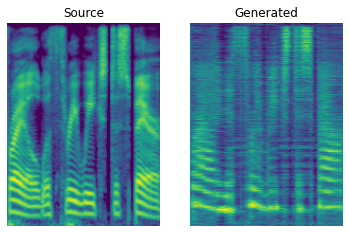

Mean D loss: 0.1330880969762802 Mean G loss: 1.8184502124786377 Mean ID loss: 0.20922726392745972
[Epoch 1/160] [Batch 0] [D loss f: 0.18811357021331787 r: 0.12940356135368347] [G loss: 1.4963778257369995] [ID loss: 0.1784558892250061] [LR: 0.0002]
[Epoch 1/160] [Batch 600] [D loss f: 0.19043761491775513 r: 0.1445542424917221] [G loss: 1.365153431892395] [ID loss: 0.18212313950061798] [LR: 0.0002]
[Epoch 1/160] [Batch 1200] [D loss f: 0.2130495309829712 r: 0.156951442360878] [G loss: 1.1627272367477417] [ID loss: 0.19545458257198334] [LR: 0.0002]
Time/Batch 0.030876662261294624
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 605.51it/s, loss=0.000156, spectral_convergence=-25.3]


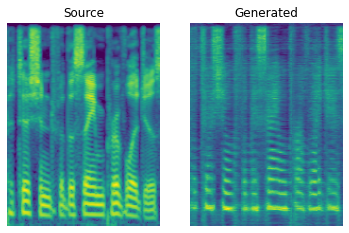

Mean D loss: 0.20874442160129547 Mean G loss: 1.2491509914398193 Mean ID loss: 0.19099391996860504
[Epoch 2/160] [Batch 0] [D loss f: 0.25682711601257324 r: 0.1639053225517273] [G loss: 1.1469212770462036] [ID loss: 0.20661567151546478] [LR: 0.0002]
[Epoch 2/160] [Batch 600] [D loss f: 0.2824763357639313 r: 0.16689878702163696] [G loss: 1.014466643333435] [ID loss: 0.21123062074184418] [LR: 0.0002]
[Epoch 2/160] [Batch 1200] [D loss f: 0.31325656175613403 r: 0.1731366366147995] [G loss: 0.9069022536277771] [ID loss: 0.21757946908473969] [LR: 0.0002]
Time/Batch 0.03086683402096268
Saving...


  5%|▌         | 100/2000 [00:00<00:03, 614.14it/s, loss=0.000268, spectral_convergence=-10.9]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 604.76it/s, loss=0.000294, spectral_convergence=-35.4]


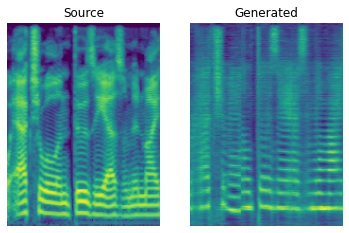

Mean D loss: 0.29929789900779724 Mean G loss: 0.9606955051422119 Mean ID loss: 0.2150939702987671
[Epoch 3/160] [Batch 0] [D loss f: 0.30973777174949646 r: 0.17771892249584198] [G loss: 0.9596717953681946] [ID loss: 0.22002950310707092] [LR: 0.0002]
[Epoch 3/160] [Batch 600] [D loss f: 0.29641541838645935 r: 0.16448211669921875] [G loss: 0.8721060156822205] [ID loss: 0.22130337357521057] [LR: 0.0002]
[Epoch 3/160] [Batch 1200] [D loss f: 0.3137318789958954 r: 0.16649900376796722] [G loss: 0.868279218673706] [ID loss: 0.22627848386764526] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030984217059003175
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 594.59it/s, loss=0.000468, spectral_convergence=-26.5]


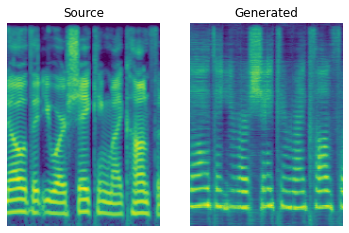

Mean D loss: 0.3054848611354828 Mean G loss: 0.8733245134353638 Mean ID loss: 0.22383612394332886
[Epoch 4/160] [Batch 0] [D loss f: 0.30846861004829407 r: 0.1505078375339508] [G loss: 0.8950598835945129] [ID loss: 0.22429072856903076] [LR: 0.0002]
[Epoch 4/160] [Batch 600] [D loss f: 0.3091689944267273 r: 0.15360979735851288] [G loss: 0.9036955833435059] [ID loss: 0.22515390813350677] [LR: 0.0002]
[Epoch 4/160] [Batch 1200] [D loss f: 0.2893047034740448 r: 0.15043844282627106] [G loss: 0.8826487064361572] [ID loss: 0.22387899458408356] [LR: 0.0002]
Time/Batch 0.03088628166783465
Saving...


  4%|▍         | 90/2000 [00:00<00:03, 580.36it/s, loss=0.000222, spectral_convergence=-9.38]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 582.86it/s, loss=0.000418, spectral_convergence=-27.8]


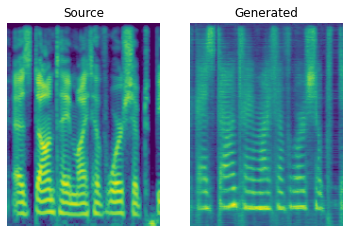

Mean D loss: 0.29767701029777527 Mean G loss: 0.8940276503562927 Mean ID loss: 0.2240508496761322
[Epoch 5/160] [Batch 0] [D loss f: 0.2862705588340759 r: 0.14733098447322845] [G loss: 0.9009575843811035] [ID loss: 0.22069904208183289] [LR: 0.0002]
[Epoch 5/160] [Batch 600] [D loss f: 0.2620792090892792 r: 0.14753463864326477] [G loss: 0.9103847146034241] [ID loss: 0.2196781188249588] [LR: 0.0002]
[Epoch 5/160] [Batch 1200] [D loss f: 0.23998689651489258 r: 0.1345331072807312] [G loss: 0.9420521855354309] [ID loss: 0.2131900191307068] [LR: 0.0002]
Time/Batch 0.030893446755235213
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 601.84it/s, loss=0.000163, spectral_convergence=-31.4]


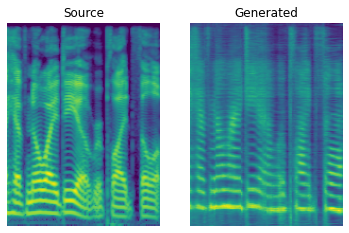

Mean D loss: 0.24789315462112427 Mean G loss: 0.932235062122345 Mean ID loss: 0.21562819182872772
[Epoch 6/160] [Batch 0] [D loss f: 0.22778886556625366 r: 0.13351739943027496] [G loss: 0.971884548664093] [ID loss: 0.2098114788532257] [LR: 0.0002]
[Epoch 6/160] [Batch 600] [D loss f: 0.238626629114151 r: 0.14980658888816833] [G loss: 0.945156991481781] [ID loss: 0.19966891407966614] [LR: 0.0002]
[Epoch 6/160] [Batch 1200] [D loss f: 0.25477519631385803 r: 0.1577838957309723] [G loss: 0.9805186986923218] [ID loss: 0.18860580027103424] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030883094516113728
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 598.36it/s, loss=0.000118, spectral_convergence=-44.6]


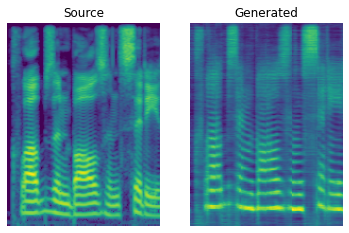

Mean D loss: 0.24825924634933472 Mean G loss: 0.9570817351341248 Mean ID loss: 0.19250020384788513
[Epoch 7/160] [Batch 0] [D loss f: 0.26022085547447205 r: 0.16894415020942688] [G loss: 0.9157032370567322] [ID loss: 0.18080957233905792] [LR: 0.0002]
[Epoch 7/160] [Batch 600] [D loss f: 0.26651906967163086 r: 0.19977828860282898] [G loss: 0.9472339153289795] [ID loss: 0.16787809133529663] [LR: 0.0002]
[Epoch 7/160] [Batch 1200] [D loss f: 0.2866126596927643 r: 0.2271268218755722] [G loss: 1.0165637731552124] [ID loss: 0.1528014987707138] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030823994030917647
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 598.10it/s, loss=0.000478, spectral_convergence=-24.8]


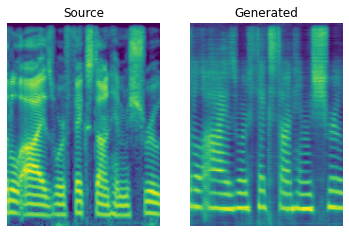

Mean D loss: 0.2803683578968048 Mean G loss: 0.9829361438751221 Mean ID loss: 0.1585012674331665
[Epoch 8/160] [Batch 0] [D loss f: 0.30387455224990845 r: 0.23668676614761353] [G loss: 0.9979353547096252] [ID loss: 0.14544539153575897] [LR: 0.0002]
[Epoch 8/160] [Batch 600] [D loss f: 0.3004342317581177 r: 0.27323344349861145] [G loss: 0.9335288405418396] [ID loss: 0.1387472301721573] [LR: 0.0002]
[Epoch 8/160] [Batch 1200] [D loss f: 0.34124064445495605 r: 0.31299009919166565] [G loss: 0.9671783447265625] [ID loss: 0.13109445571899414] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03087090488767972
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 601.91it/s, loss=0.000351, spectral_convergence=-27.6]


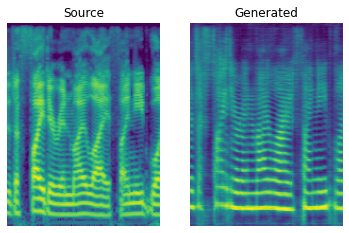

Mean D loss: 0.3258724808692932 Mean G loss: 0.975151777267456 Mean ID loss: 0.13406196236610413
[Epoch 9/160] [Batch 0] [D loss f: 0.3634337782859802 r: 0.3127702474594116] [G loss: 1.1425364017486572] [ID loss: 0.12794677913188934] [LR: 0.0002]
[Epoch 9/160] [Batch 600] [D loss f: 0.36738577485084534 r: 0.33911484479904175] [G loss: 1.0251688957214355] [ID loss: 0.12828603386878967] [LR: 0.0002]
[Epoch 9/160] [Batch 1200] [D loss f: 0.3650149405002594 r: 0.36742886900901794] [G loss: 0.9896770119667053] [ID loss: 0.12759728729724884] [LR: 0.0002]
Time/Batch 0.0310022239267391
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 601.26it/s, loss=0.000376, spectral_convergence=-27.4]


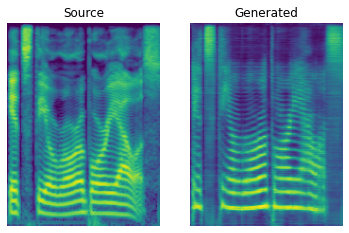

Mean D loss: 0.3655454218387604 Mean G loss: 1.0103901624679565 Mean ID loss: 0.1279952973127365
[Epoch 10/160] [Batch 0] [D loss f: 0.3590540289878845 r: 0.37622830271720886] [G loss: 1.034783959388733] [ID loss: 0.128367081284523] [LR: 0.0002]
[Epoch 10/160] [Batch 600] [D loss f: 0.37163838744163513 r: 0.39123427867889404] [G loss: 0.9970229268074036] [ID loss: 0.1287716180086136] [LR: 0.0002]
[Epoch 10/160] [Batch 1200] [D loss f: 0.38235920667648315 r: 0.40608033537864685] [G loss: 0.9938924312591553] [ID loss: 0.13093172013759613] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030844324522644934
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 602.38it/s, loss=0.000319, spectral_convergence=-29]


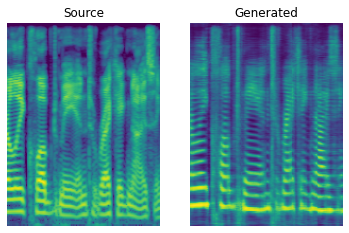

Mean D loss: 0.37558475136756897 Mean G loss: 0.9964554309844971 Mean ID loss: 0.1300128847360611
[Epoch 11/160] [Batch 0] [D loss f: 0.3676442503929138 r: 0.42882463335990906] [G loss: 1.000162959098816] [ID loss: 0.13118574023246765] [LR: 0.0002]
[Epoch 11/160] [Batch 600] [D loss f: 0.3767208456993103 r: 0.4159928858280182] [G loss: 0.985443651676178] [ID loss: 0.13104233145713806] [LR: 0.0002]
[Epoch 11/160] [Batch 1200] [D loss f: 0.3835895359516144 r: 0.41925737261772156] [G loss: 1.0137240886688232] [ID loss: 0.13240958750247955] [LR: 0.0002]
Time/Batch 0.030898722592931593
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 599.80it/s, loss=9.89e-5, spectral_convergence=-43.8]


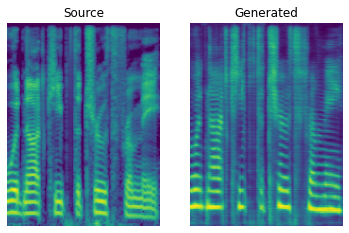

Mean D loss: 0.3806438744068146 Mean G loss: 0.998184859752655 Mean ID loss: 0.13183574378490448
[Epoch 12/160] [Batch 0] [D loss f: 0.38265517354011536 r: 0.42682161927223206] [G loss: 0.9915046095848083] [ID loss: 0.13259676098823547] [LR: 0.0002]
[Epoch 12/160] [Batch 600] [D loss f: 0.3909115493297577 r: 0.44079646468162537] [G loss: 0.9854211211204529] [ID loss: 0.13221517205238342] [LR: 0.0002]
[Epoch 12/160] [Batch 1200] [D loss f: 0.3829915225505829 r: 0.43131983280181885] [G loss: 0.9431349635124207] [ID loss: 0.13309535384178162] [LR: 0.0002]
Time/Batch 0.030923676142727372
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 597.59it/s, loss=0.000279, spectral_convergence=-23.3]


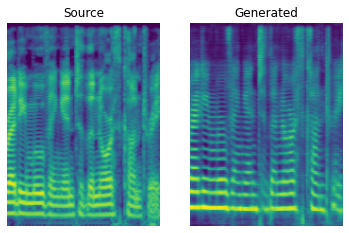

Mean D loss: 0.38628798723220825 Mean G loss: 0.9684564471244812 Mean ID loss: 0.13266776502132416
[Epoch 13/160] [Batch 0] [D loss f: 0.38233110308647156 r: 0.42771223187446594] [G loss: 0.9953058362007141] [ID loss: 0.13278448581695557] [LR: 0.0002]
[Epoch 13/160] [Batch 600] [D loss f: 0.4001832604408264 r: 0.4326014220714569] [G loss: 0.9550625681877136] [ID loss: 0.13375656306743622] [LR: 0.0002]
[Epoch 13/160] [Batch 1200] [D loss f: 0.3834838271141052 r: 0.44465959072113037] [G loss: 0.9344761371612549] [ID loss: 0.13194383680820465] [LR: 0.0002]
Time/Batch 0.030882502298285493
Saving...
(5, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 604.35it/s, loss=0.000203, spectral_convergence=-40.1]


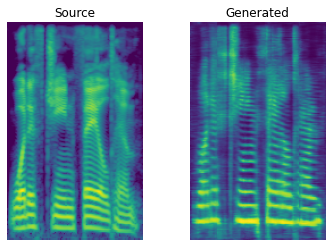

Mean D loss: 0.38720938563346863 Mean G loss: 0.9316213726997375 Mean ID loss: 0.13291431963443756
[Epoch 14/160] [Batch 0] [D loss f: 0.3532397150993347 r: 0.4554024934768677] [G loss: 0.8445743322372437] [ID loss: 0.13335692882537842] [LR: 0.0002]
[Epoch 14/160] [Batch 600] [D loss f: 0.3853587806224823 r: 0.4453744888305664] [G loss: 0.8392977118492126] [ID loss: 0.13329938054084778] [LR: 0.0002]
[Epoch 14/160] [Batch 1200] [D loss f: 0.37400713562965393 r: 0.4489196836948395] [G loss: 0.886039137840271] [ID loss: 0.13407817482948303] [LR: 0.0002]
Time/Batch 0.030872992703514377
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 606.26it/s, loss=0.0003, spectral_convergence=-17.9]


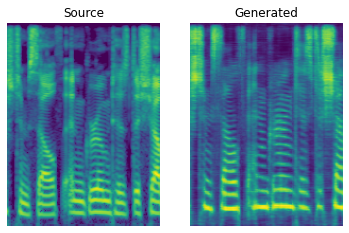

Mean D loss: 0.37834632396698 Mean G loss: 0.8839598298072815 Mean ID loss: 0.13355764746665955
[Epoch 15/160] [Batch 0] [D loss f: 0.3704739511013031 r: 0.45326653122901917] [G loss: 1.0281883478164673] [ID loss: 0.13264794647693634] [LR: 0.0002]
[Epoch 15/160] [Batch 600] [D loss f: 0.37836724519729614 r: 0.4431917369365692] [G loss: 0.939700722694397] [ID loss: 0.1310519576072693] [LR: 0.0002]
[Epoch 15/160] [Batch 1200] [D loss f: 0.37988489866256714 r: 0.4422226846218109] [G loss: 0.8735925555229187] [ID loss: 0.13104590773582458] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030873067709651307
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 600.41it/s, loss=0.000269, spectral_convergence=-33.3]


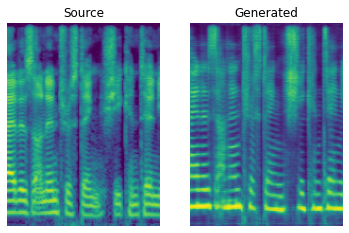

Mean D loss: 0.3814563751220703 Mean G loss: 0.9200199842453003 Mean ID loss: 0.13083596527576447
[Epoch 16/160] [Batch 0] [D loss f: 0.3977540135383606 r: 0.45355796813964844] [G loss: 1.0144932270050049] [ID loss: 0.12928171455860138] [LR: 0.0002]
[Epoch 16/160] [Batch 600] [D loss f: 0.38412952423095703 r: 0.4398893713951111] [G loss: 0.9724056124687195] [ID loss: 0.12966610491275787] [LR: 0.0002]
[Epoch 16/160] [Batch 1200] [D loss f: 0.3746659457683563 r: 0.455063134431839] [G loss: 0.8116293549537659] [ID loss: 0.129251167178154] [LR: 0.0002]
Time/Batch 0.030864939202357382
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 602.13it/s, loss=0.000106, spectral_convergence=-25.5]


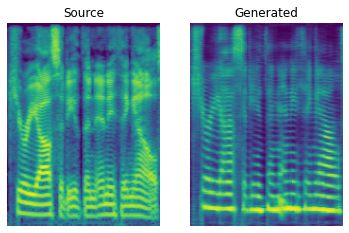

Mean D loss: 0.37873154878616333 Mean G loss: 0.8834452033042908 Mean ID loss: 0.1295958161354065
[Epoch 17/160] [Batch 0] [D loss f: 0.37735867500305176 r: 0.43465322256088257] [G loss: 0.8189101219177246] [ID loss: 0.1305655539035797] [LR: 0.0002]
[Epoch 17/160] [Batch 600] [D loss f: 0.37223929166793823 r: 0.4405571520328522] [G loss: 0.8960846066474915] [ID loss: 0.1286161094903946] [LR: 0.0002]
[Epoch 17/160] [Batch 1200] [D loss f: 0.3723924160003662 r: 0.4418700039386749] [G loss: 0.8371134400367737] [ID loss: 0.12775176763534546] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03084789001158554
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 599.74it/s, loss=0.000282, spectral_convergence=-36.3]


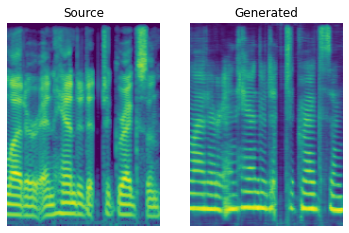

Mean D loss: 0.37400931119918823 Mean G loss: 0.8787070512771606 Mean ID loss: 0.12809410691261292
[Epoch 18/160] [Batch 0] [D loss f: 0.38460612297058105 r: 0.4495862126350403] [G loss: 0.9650788903236389] [ID loss: 0.12748172879219055] [LR: 0.0002]
[Epoch 18/160] [Batch 600] [D loss f: 0.38253748416900635 r: 0.4376617968082428] [G loss: 0.903059184551239] [ID loss: 0.12558209896087646] [LR: 0.0002]
[Epoch 18/160] [Batch 1200] [D loss f: 0.3784862756729126 r: 0.43717071413993835] [G loss: 0.8039517402648926] [ID loss: 0.1265539526939392] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030870953789592658
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 604.46it/s, loss=0.000307, spectral_convergence=-32.3]


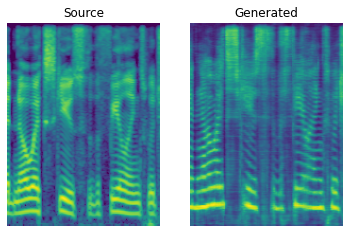

Mean D loss: 0.3802949786186218 Mean G loss: 0.8485468626022339 Mean ID loss: 0.12597399950027466
[Epoch 19/160] [Batch 0] [D loss f: 0.376483678817749 r: 0.43565043807029724] [G loss: 0.8171988129615784] [ID loss: 0.12527549266815186] [LR: 0.0002]
[Epoch 19/160] [Batch 600] [D loss f: 0.3742295205593109 r: 0.4352751076221466] [G loss: 0.8525374531745911] [ID loss: 0.1250200718641281] [LR: 0.0002]
[Epoch 19/160] [Batch 1200] [D loss f: 0.3791428506374359 r: 0.43097540736198425] [G loss: 0.7919408082962036] [ID loss: 0.12368817627429962] [LR: 0.0002]
Time/Batch 0.03103019964956019
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 605.06it/s, loss=0.000275, spectral_convergence=-37.5]


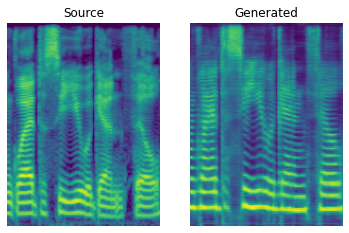

Mean D loss: 0.3780497908592224 Mean G loss: 0.826772153377533 Mean ID loss: 0.12420645356178284
[Epoch 20/160] [Batch 0] [D loss f: 0.3864169120788574 r: 0.43919819593429565] [G loss: 0.8620175123214722] [ID loss: 0.12316687405109406] [LR: 0.0002]
[Epoch 20/160] [Batch 600] [D loss f: 0.38460713624954224 r: 0.435280442237854] [G loss: 0.7972268462181091] [ID loss: 0.12260612845420837] [LR: 0.0002]
[Epoch 20/160] [Batch 1200] [D loss f: 0.3776113986968994 r: 0.4242563545703888] [G loss: 0.7829989194869995] [ID loss: 0.1221250519156456] [LR: 0.0002]
Time/Batch 0.030856893358439424
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 601.23it/s, loss=0.000316, spectral_convergence=-25.1]


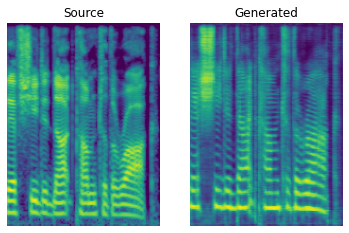

Mean D loss: 0.38068437576293945 Mean G loss: 0.7933688759803772 Mean ID loss: 0.12233860790729523
[Epoch 21/160] [Batch 0] [D loss f: 0.37902194261550903 r: 0.43774673342704773] [G loss: 0.8117352724075317] [ID loss: 0.12212708592414856] [LR: 0.0002]
[Epoch 21/160] [Batch 600] [D loss f: 0.394397109746933 r: 0.43330514430999756] [G loss: 0.9217199683189392] [ID loss: 0.12106290459632874] [LR: 0.0002]
[Epoch 21/160] [Batch 1200] [D loss f: 0.3845490515232086 r: 0.4158143997192383] [G loss: 0.7557145953178406] [ID loss: 0.12025199830532074] [LR: 0.0002]
Time/Batch 0.03084462646150241
Saving...
(4, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 600.24it/s, loss=0.000143, spectral_convergence=-38.9]


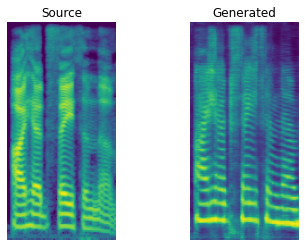

Mean D loss: 0.38802048563957214 Mean G loss: 0.8335081934928894 Mean ID loss: 0.12047974765300751
[Epoch 22/160] [Batch 0] [D loss f: 0.38153964281082153 r: 0.41745489835739136] [G loss: 0.7929386496543884] [ID loss: 0.1192990317940712] [LR: 0.0002]
[Epoch 22/160] [Batch 600] [D loss f: 0.38801309466362 r: 0.4185197055339813] [G loss: 0.817272961139679] [ID loss: 0.11929593235254288] [LR: 0.0002]
[Epoch 22/160] [Batch 1200] [D loss f: 0.3746892213821411 r: 0.41024866700172424] [G loss: 0.7616429924964905] [ID loss: 0.11811719089746475] [LR: 0.0002]
Time/Batch 0.030840154111820416
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 598.89it/s, loss=0.000642, spectral_convergence=-27.5]


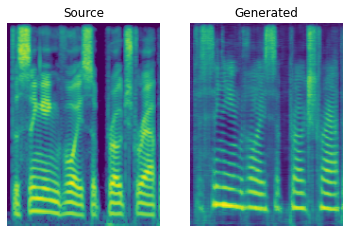

Mean D loss: 0.38247188925743103 Mean G loss: 0.7910699248313904 Mean ID loss: 0.11856892704963684
[Epoch 23/160] [Batch 0] [D loss f: 0.3862588405609131 r: 0.405833899974823] [G loss: 0.8070377707481384] [ID loss: 0.11755368858575821] [LR: 0.0002]
[Epoch 23/160] [Batch 600] [D loss f: 0.38801735639572144 r: 0.4138868749141693] [G loss: 0.7877745032310486] [ID loss: 0.11778367310762405] [LR: 0.0002]
[Epoch 23/160] [Batch 1200] [D loss f: 0.3865406811237335 r: 0.4104655981063843] [G loss: 0.7707822918891907] [ID loss: 0.11776965111494064] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030840115129512593
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 604.91it/s, loss=0.00065, spectral_convergence=-22.7]


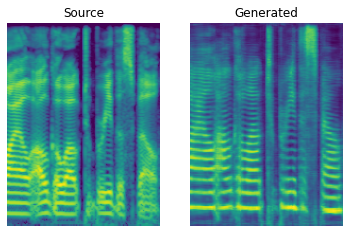

Mean D loss: 0.38723254203796387 Mean G loss: 0.7960392832756042 Mean ID loss: 0.11780984699726105
[Epoch 24/160] [Batch 0] [D loss f: 0.3891090750694275 r: 0.4020578861236572] [G loss: 0.9108920693397522] [ID loss: 0.11800480633974075] [LR: 0.0002]
[Epoch 24/160] [Batch 600] [D loss f: 0.382699579000473 r: 0.4179258346557617] [G loss: 0.7694699168205261] [ID loss: 0.11744821816682816] [LR: 0.0002]
[Epoch 24/160] [Batch 1200] [D loss f: 0.3822127878665924 r: 0.4096883237361908] [G loss: 0.8302527070045471] [ID loss: 0.11782185733318329] [LR: 0.0002]
Time/Batch 0.03086264725149113
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 590.36it/s, loss=0.000273, spectral_convergence=-23.7]


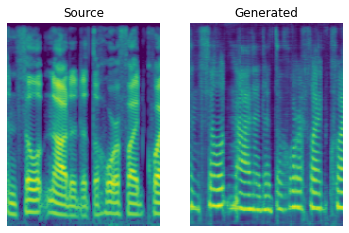

Mean D loss: 0.3833644986152649 Mean G loss: 0.7904108762741089 Mean ID loss: 0.11772487312555313
[Epoch 25/160] [Batch 0] [D loss f: 0.3876539170742035 r: 0.4155441224575043] [G loss: 0.7274802327156067] [ID loss: 0.11837878078222275] [LR: 0.0002]
[Epoch 25/160] [Batch 600] [D loss f: 0.38674113154411316 r: 0.40115585923194885] [G loss: 0.772238552570343] [ID loss: 0.11752098053693771] [LR: 0.0002]
[Epoch 25/160] [Batch 1200] [D loss f: 0.3951316177845001 r: 0.40395304560661316] [G loss: 0.8046391606330872] [ID loss: 0.11711039394140244] [LR: 0.0002]
Time/Batch 0.03086668922953362
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 596.67it/s, loss=0.000397, spectral_convergence=-26.3]


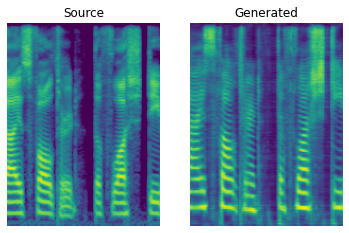

Mean D loss: 0.39044907689094543 Mean G loss: 0.7877894639968872 Mean ID loss: 0.1171230599284172
[Epoch 26/160] [Batch 0] [D loss f: 0.38634753227233887 r: 0.39986780285835266] [G loss: 0.7834417223930359] [ID loss: 0.11573676764965057] [LR: 0.0002]
[Epoch 26/160] [Batch 600] [D loss f: 0.3913687765598297 r: 0.40813401341438293] [G loss: 0.7649471759796143] [ID loss: 0.11610124260187149] [LR: 0.0002]
[Epoch 26/160] [Batch 1200] [D loss f: 0.3871821463108063 r: 0.4099164307117462] [G loss: 0.7666792273521423] [ID loss: 0.11619848757982254] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03083953927033139
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 603.24it/s, loss=0.000424, spectral_convergence=-30.4]


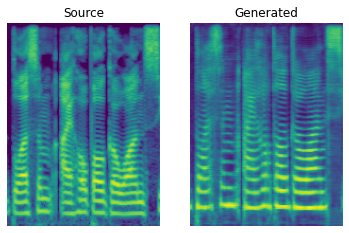

Mean D loss: 0.3891570270061493 Mean G loss: 0.7553951144218445 Mean ID loss: 0.1160634234547615
[Epoch 27/160] [Batch 0] [D loss f: 0.3915283977985382 r: 0.4012146294116974] [G loss: 0.6782012581825256] [ID loss: 0.11545299738645554] [LR: 0.0002]
[Epoch 27/160] [Batch 600] [D loss f: 0.3853461742401123 r: 0.4017513692378998] [G loss: 0.7471145987510681] [ID loss: 0.11492256075143814] [LR: 0.0002]
[Epoch 27/160] [Batch 1200] [D loss f: 0.3925763964653015 r: 0.39736101031303406] [G loss: 0.7892402410507202] [ID loss: 0.11580215394496918] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030834829198182933
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 592.10it/s, loss=0.000539, spectral_convergence=-17.7]


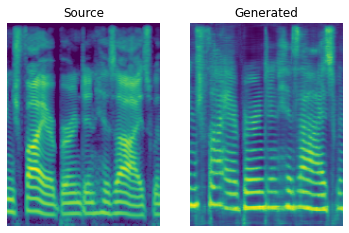

Mean D loss: 0.38861551880836487 Mean G loss: 0.7619103789329529 Mean ID loss: 0.11523345112800598
[Epoch 28/160] [Batch 0] [D loss f: 0.3878079354763031 r: 0.40335965156555176] [G loss: 0.7163057923316956] [ID loss: 0.1143268346786499] [LR: 0.0002]
[Epoch 28/160] [Batch 600] [D loss f: 0.3867810368537903 r: 0.4117785692214966] [G loss: 0.706286609172821] [ID loss: 0.11419575661420822] [LR: 0.0002]
[Epoch 28/160] [Batch 1200] [D loss f: 0.3895235061645508 r: 0.40998756885528564] [G loss: 0.7731444835662842] [ID loss: 0.11499065160751343] [LR: 0.0002]
Time/Batch 0.03081587509517252
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 600.08it/s, loss=0.000346, spectral_convergence=-32.1]


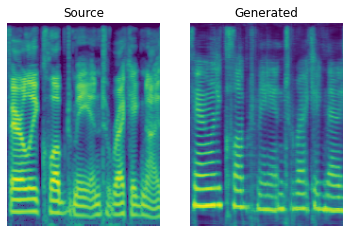

Mean D loss: 0.387165367603302 Mean G loss: 0.7335827350616455 Mean ID loss: 0.1147957295179367
[Epoch 29/160] [Batch 0] [D loss f: 0.3778071403503418 r: 0.40049511194229126] [G loss: 0.693033754825592] [ID loss: 0.11625893414020538] [LR: 0.0002]
[Epoch 29/160] [Batch 600] [D loss f: 0.38439831137657166 r: 0.4057069420814514] [G loss: 0.7565960884094238] [ID loss: 0.11467455327510834] [LR: 0.0002]
[Epoch 29/160] [Batch 1200] [D loss f: 0.3932691216468811 r: 0.4035148024559021] [G loss: 0.8168396949768066] [ID loss: 0.11398394405841827] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030854267621562428
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 584.52it/s, loss=0.000225, spectral_convergence=-36.6]


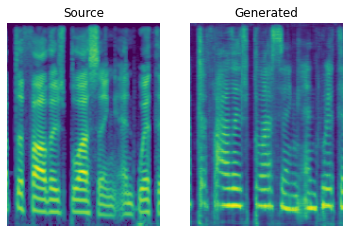

Mean D loss: 0.39039772748947144 Mean G loss: 0.7742294073104858 Mean ID loss: 0.1142941489815712
[Epoch 30/160] [Batch 0] [D loss f: 0.3994067311286926 r: 0.3956558406352997] [G loss: 0.6895480751991272] [ID loss: 0.11400779336690903] [LR: 0.0002]
[Epoch 30/160] [Batch 600] [D loss f: 0.37755247950553894 r: 0.4070836007595062] [G loss: 0.7082597017288208] [ID loss: 0.11366671323776245] [LR: 0.0002]
[Epoch 30/160] [Batch 1200] [D loss f: 0.3901611864566803 r: 0.4009411931037903] [G loss: 0.7317444086074829] [ID loss: 0.11324841529130936] [LR: 0.0002]
Time/Batch 0.030869240134301847
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 598.98it/s, loss=0.00072, spectral_convergence=-17.9]


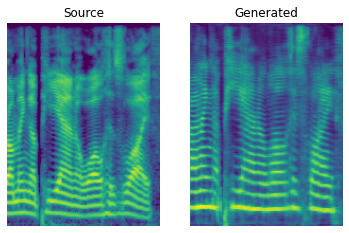

Mean D loss: 0.3833620846271515 Mean G loss: 0.7167243361473083 Mean ID loss: 0.11328310519456863
[Epoch 31/160] [Batch 0] [D loss f: 0.38444143533706665 r: 0.3969655930995941] [G loss: 0.6881253123283386] [ID loss: 0.11215167492628098] [LR: 0.0002]
[Epoch 31/160] [Batch 600] [D loss f: 0.37645313143730164 r: 0.4078875780105591] [G loss: 0.7134348750114441] [ID loss: 0.11319786310195923] [LR: 0.0002]
[Epoch 31/160] [Batch 1200] [D loss f: 0.3881815969944 r: 0.4113541543483734] [G loss: 0.7294206023216248] [ID loss: 0.11320920288562775] [LR: 0.0002]
Time/Batch 0.030868717875793903
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 609.39it/s, loss=0.000251, spectral_convergence=-30.8]


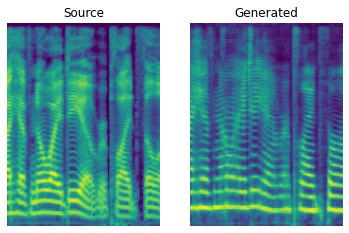

Mean D loss: 0.3836909532546997 Mean G loss: 0.724989116191864 Mean ID loss: 0.11330259591341019
[Epoch 32/160] [Batch 0] [D loss f: 0.3897705078125 r: 0.4033704698085785] [G loss: 0.7537922263145447] [ID loss: 0.113893061876297] [LR: 0.0002]
[Epoch 32/160] [Batch 600] [D loss f: 0.38731634616851807 r: 0.41623541712760925] [G loss: 0.8250885009765625] [ID loss: 0.11281729489564896] [LR: 0.0002]
[Epoch 32/160] [Batch 1200] [D loss f: 0.396906316280365 r: 0.4034237265586853] [G loss: 0.7765071392059326] [ID loss: 0.11291255801916122] [LR: 0.0002]
Time/Batch 0.03101132681770046
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 605.81it/s, loss=0.000274, spectral_convergence=-30.5]


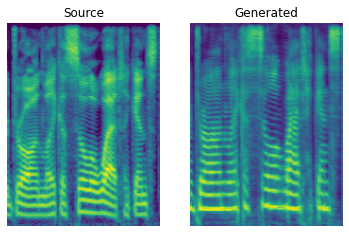

Mean D loss: 0.3912922441959381 Mean G loss: 0.8158387541770935 Mean ID loss: 0.1127622053027153
[Epoch 33/160] [Batch 0] [D loss f: 0.3852783441543579 r: 0.3983592391014099] [G loss: 0.9216942191123962] [ID loss: 0.11204396188259125] [LR: 0.0002]
[Epoch 33/160] [Batch 600] [D loss f: 0.39782893657684326 r: 0.41089239716529846] [G loss: 0.7591943144798279] [ID loss: 0.11243456602096558] [LR: 0.0002]
[Epoch 33/160] [Batch 1200] [D loss f: 0.3859714865684509 r: 0.4150746762752533] [G loss: 0.6897720098495483] [ID loss: 0.11207283288240433] [LR: 0.0002]
Time/Batch 0.03085654025530293
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 595.20it/s, loss=0.000142, spectral_convergence=-38.7]


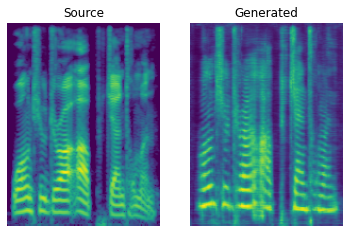

Mean D loss: 0.39119768142700195 Mean G loss: 0.7167015075683594 Mean ID loss: 0.1121864914894104
[Epoch 34/160] [Batch 0] [D loss f: 0.38677719235420227 r: 0.41161254048347473] [G loss: 0.6620291471481323] [ID loss: 0.11175429821014404] [LR: 0.0002]
[Epoch 34/160] [Batch 600] [D loss f: 0.3865804672241211 r: 0.4057607054710388] [G loss: 0.7804769277572632] [ID loss: 0.11244012415409088] [LR: 0.0002]
[Epoch 34/160] [Batch 1200] [D loss f: 0.37978509068489075 r: 0.40822866559028625] [G loss: 0.7229275107383728] [ID loss: 0.11221129447221756] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03082725584071918
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 602.36it/s, loss=0.000179, spectral_convergence=-42.9]


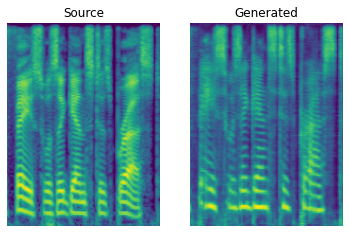

Mean D loss: 0.38483619689941406 Mean G loss: 0.7589302659034729 Mean ID loss: 0.11233734339475632
[Epoch 35/160] [Batch 0] [D loss f: 0.3946695625782013 r: 0.40650466084480286] [G loss: 0.8119056224822998] [ID loss: 0.1123778373003006] [LR: 0.0002]
[Epoch 35/160] [Batch 600] [D loss f: 0.3826315701007843 r: 0.4147941470146179] [G loss: 0.7285042405128479] [ID loss: 0.11154710501432419] [LR: 0.0002]
[Epoch 35/160] [Batch 1200] [D loss f: 0.39118826389312744 r: 0.41083571314811707] [G loss: 0.7316879034042358] [ID loss: 0.11060306429862976] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03083380347620832
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 607.24it/s, loss=0.000434, spectral_convergence=-26.1]


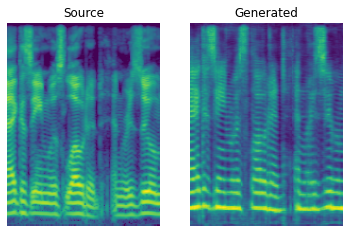

Mean D loss: 0.38606494665145874 Mean G loss: 0.7162749171257019 Mean ID loss: 0.11115103214979172
[Epoch 36/160] [Batch 0] [D loss f: 0.3801168203353882 r: 0.4077701270580292] [G loss: 0.6193075776100159] [ID loss: 0.11165032535791397] [LR: 0.0002]
[Epoch 36/160] [Batch 600] [D loss f: 0.3901704251766205 r: 0.41094911098480225] [G loss: 0.6903497576713562] [ID loss: 0.11127921938896179] [LR: 0.0002]
[Epoch 36/160] [Batch 1200] [D loss f: 0.38905420899391174 r: 0.41694211959838867] [G loss: 0.7697957754135132] [ID loss: 0.11087219417095184] [LR: 0.0002]
Time/Batch 0.030850883295936306
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 594.14it/s, loss=0.000151, spectral_convergence=-44.1]


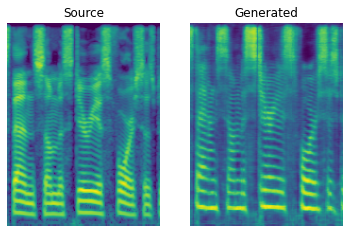

Mean D loss: 0.38910144567489624 Mean G loss: 0.7312172651290894 Mean ID loss: 0.1109762042760849
[Epoch 37/160] [Batch 0] [D loss f: 0.3878094553947449 r: 0.40681886672973633] [G loss: 0.7358910441398621] [ID loss: 0.11029575765132904] [LR: 0.0002]
[Epoch 37/160] [Batch 600] [D loss f: 0.3881271481513977 r: 0.4199816882610321] [G loss: 0.7444002032279968] [ID loss: 0.11077501624822617] [LR: 0.0002]
[Epoch 37/160] [Batch 1200] [D loss f: 0.3769390881061554 r: 0.41830286383628845] [G loss: 0.6583909392356873] [ID loss: 0.11122633516788483] [LR: 0.0002]
Time/Batch 0.030823434008299
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 603.35it/s, loss=0.000368, spectral_convergence=-28.9]


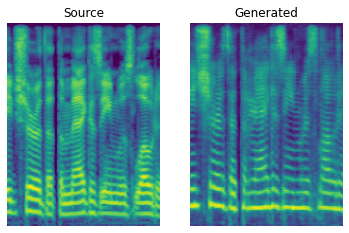

Mean D loss: 0.3827163279056549 Mean G loss: 0.6842358112335205 Mean ID loss: 0.11100047081708908
[Epoch 38/160] [Batch 0] [D loss f: 0.3820406496524811 r: 0.4256088137626648] [G loss: 0.5667572617530823] [ID loss: 0.11099745333194733] [LR: 0.0002]
[Epoch 38/160] [Batch 600] [D loss f: 0.39032408595085144 r: 0.4110836982727051] [G loss: 0.7751748561859131] [ID loss: 0.1111399307847023] [LR: 0.0002]
[Epoch 38/160] [Batch 1200] [D loss f: 0.3847738206386566 r: 0.4083558917045593] [G loss: 0.7597883343696594] [ID loss: 0.11037684231996536] [LR: 0.0002]
Time/Batch 0.0308449882660469
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 598.11it/s, loss=0.000683, spectral_convergence=-26.3]


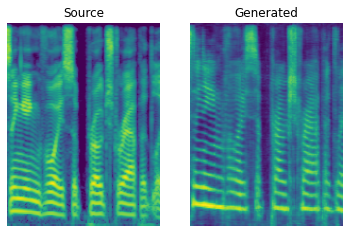

Mean D loss: 0.3865879476070404 Mean G loss: 0.7572575211524963 Mean ID loss: 0.11076395958662033
[Epoch 39/160] [Batch 0] [D loss f: 0.3804606795310974 r: 0.4064359664916992] [G loss: 0.6846625804901123] [ID loss: 0.11081477254629135] [LR: 0.0002]
[Epoch 39/160] [Batch 600] [D loss f: 0.38684308528900146 r: 0.41518858075141907] [G loss: 0.7291573882102966] [ID loss: 0.10989430546760559] [LR: 0.0002]
[Epoch 39/160] [Batch 1200] [D loss f: 0.38957080245018005 r: 0.4136761426925659] [G loss: 0.7058718800544739] [ID loss: 0.11027557402849197] [LR: 0.0002]
Time/Batch 0.0308493950071126
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 604.88it/s, loss=0.000121, spectral_convergence=-42]


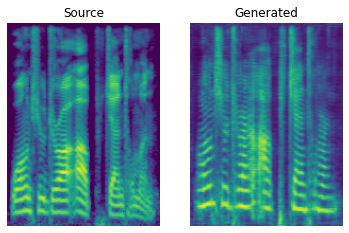

Mean D loss: 0.3872504234313965 Mean G loss: 0.7214404344558716 Mean ID loss: 0.1099788099527359
[Epoch 40/160] [Batch 0] [D loss f: 0.3810712993144989 r: 0.42167574167251587] [G loss: 0.7479232549667358] [ID loss: 0.10924728214740753] [LR: 0.0002]
[Epoch 40/160] [Batch 600] [D loss f: 0.39279523491859436 r: 0.41129907965660095] [G loss: 0.7644641995429993] [ID loss: 0.10978160798549652] [LR: 0.0002]
[Epoch 40/160] [Batch 1200] [D loss f: 0.3832013010978699 r: 0.4150075316429138] [G loss: 0.6749976873397827] [ID loss: 0.11010663211345673] [LR: 0.0002]
Time/Batch 0.030838948096672113
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 605.07it/s, loss=0.000321, spectral_convergence=-31.4]


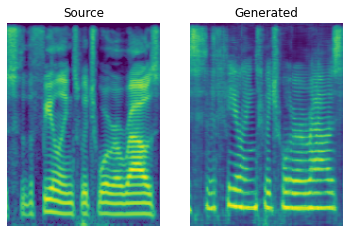

Mean D loss: 0.3856090009212494 Mean G loss: 0.7055119276046753 Mean ID loss: 0.11005540192127228
[Epoch 41/160] [Batch 0] [D loss f: 0.36757558584213257 r: 0.42564964294433594] [G loss: 0.6076586246490479] [ID loss: 0.11081945151090622] [LR: 0.0002]
[Epoch 41/160] [Batch 600] [D loss f: 0.3896516263484955 r: 0.4085679352283478] [G loss: 0.7568952441215515] [ID loss: 0.11035485565662384] [LR: 0.0002]
[Epoch 41/160] [Batch 1200] [D loss f: 0.3854885995388031 r: 0.40542399883270264] [G loss: 0.7418918013572693] [ID loss: 0.10993652045726776] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030839689978717888
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 603.75it/s, loss=0.000465, spectral_convergence=-23.3]


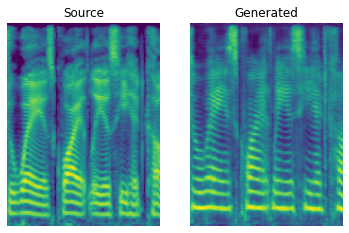

Mean D loss: 0.38454240560531616 Mean G loss: 0.7379597425460815 Mean ID loss: 0.1099524199962616
[Epoch 42/160] [Batch 0] [D loss f: 0.36291560530662537 r: 0.4269212782382965] [G loss: 0.6592977643013] [ID loss: 0.10863404721021652] [LR: 0.0002]
[Epoch 42/160] [Batch 600] [D loss f: 0.3768675625324249 r: 0.41333043575286865] [G loss: 0.6732010245323181] [ID loss: 0.10956841707229614] [LR: 0.0002]
[Epoch 42/160] [Batch 1200] [D loss f: 0.3915848433971405 r: 0.41114678978919983] [G loss: 0.7819545269012451] [ID loss: 0.10914736241102219] [LR: 0.0002]
Time/Batch 0.030836641353412266
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 606.86it/s, loss=0.000293, spectral_convergence=-29.8]


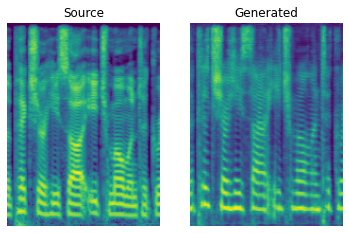

Mean D loss: 0.38400202989578247 Mean G loss: 0.7236241698265076 Mean ID loss: 0.1094333827495575
[Epoch 43/160] [Batch 0] [D loss f: 0.386890709400177 r: 0.41103532910346985] [G loss: 0.6891974210739136] [ID loss: 0.10991539061069489] [LR: 0.0002]
[Epoch 43/160] [Batch 600] [D loss f: 0.38518524169921875 r: 0.41803959012031555] [G loss: 0.7113461494445801] [ID loss: 0.10899823158979416] [LR: 0.0002]
[Epoch 43/160] [Batch 1200] [D loss f: 0.3829062879085541 r: 0.4035476744174957] [G loss: 0.7200910449028015] [ID loss: 0.1092519611120224] [LR: 0.0002]
Time/Batch 0.03088133874600821
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 602.68it/s, loss=0.00013, spectral_convergence=-37.3]


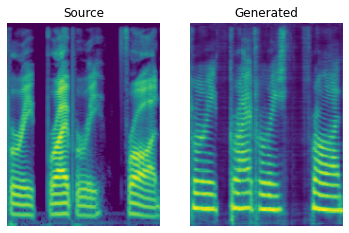

Mean D loss: 0.3845275938510895 Mean G loss: 0.7176937460899353 Mean ID loss: 0.1091153472661972
[Epoch 44/160] [Batch 0] [D loss f: 0.3839242160320282 r: 0.4138748049736023] [G loss: 0.7366160750389099] [ID loss: 0.10905633121728897] [LR: 0.0002]
[Epoch 44/160] [Batch 600] [D loss f: 0.37985292077064514 r: 0.4079214334487915] [G loss: 0.689607560634613] [ID loss: 0.1090501919388771] [LR: 0.0002]
[Epoch 44/160] [Batch 1200] [D loss f: 0.3721429407596588 r: 0.4195387065410614] [G loss: 0.6947540044784546] [ID loss: 0.10862192511558533] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030875762361679635
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 611.36it/s, loss=0.0004, spectral_convergence=-28.9]


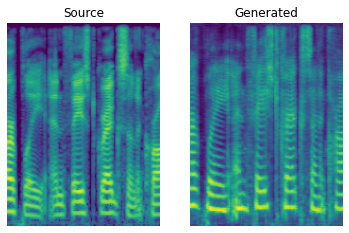

Mean D loss: 0.37760818004608154 Mean G loss: 0.69677734375 Mean ID loss: 0.10890410095453262
[Epoch 45/160] [Batch 0] [D loss f: 0.38925862312316895 r: 0.40851297974586487] [G loss: 0.7288888692855835] [ID loss: 0.10939978808164597] [LR: 0.0002]
[Epoch 45/160] [Batch 600] [D loss f: 0.38079237937927246 r: 0.409822016954422] [G loss: 0.6832027435302734] [ID loss: 0.10883806645870209] [LR: 0.0002]
[Epoch 45/160] [Batch 1200] [D loss f: 0.373323917388916 r: 0.4120444357395172] [G loss: 0.6782877445220947] [ID loss: 0.1088506281375885] [LR: 0.0002]
Time/Batch 0.030950944615106512
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 616.69it/s, loss=0.000261, spectral_convergence=-38.4]


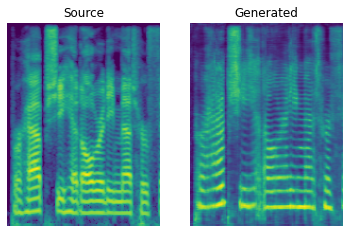

Mean D loss: 0.37865984439849854 Mean G loss: 0.7022438049316406 Mean ID loss: 0.10885018855333328
[Epoch 46/160] [Batch 0] [D loss f: 0.3948507606983185 r: 0.3888032138347626] [G loss: 0.8468656539916992] [ID loss: 0.10885483771562576] [LR: 0.0002]
[Epoch 46/160] [Batch 600] [D loss f: 0.3823454678058624 r: 0.4059974253177643] [G loss: 0.7520626187324524] [ID loss: 0.10750862210988998] [LR: 0.0002]
[Epoch 46/160] [Batch 1200] [D loss f: 0.382464200258255 r: 0.41223442554473877] [G loss: 0.7128419280052185] [ID loss: 0.10792528837919235] [LR: 0.0002]
Time/Batch 0.031242476414589986
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 594.85it/s, loss=0.000118, spectral_convergence=-34.6]


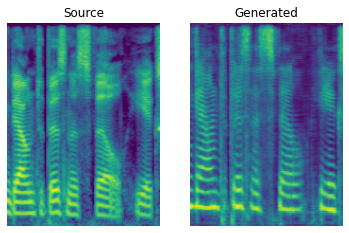

Mean D loss: 0.3821941018104553 Mean G loss: 0.7469356656074524 Mean ID loss: 0.10780692100524902
[Epoch 47/160] [Batch 0] [D loss f: 0.37921205163002014 r: 0.3931692838668823] [G loss: 0.8500767946243286] [ID loss: 0.10845400393009186] [LR: 0.0002]
[Epoch 47/160] [Batch 600] [D loss f: 0.37954476475715637 r: 0.4056142270565033] [G loss: 0.7576535940170288] [ID loss: 0.10776460915803909] [LR: 0.0002]
[Epoch 47/160] [Batch 1200] [D loss f: 0.38436782360076904 r: 0.4072360694408417] [G loss: 0.7688445448875427] [ID loss: 0.10804817080497742] [LR: 0.0002]
Time/Batch 0.03089822522045052
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 592.27it/s, loss=0.000265, spectral_convergence=-32.8]


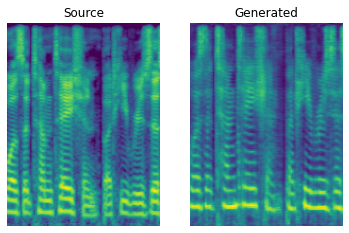

Mean D loss: 0.38131898641586304 Mean G loss: 0.7531542181968689 Mean ID loss: 0.10792699456214905
[Epoch 48/160] [Batch 0] [D loss f: 0.37432852387428284 r: 0.41034096479415894] [G loss: 0.6850883364677429] [ID loss: 0.10806078463792801] [LR: 0.0002]
[Epoch 48/160] [Batch 600] [D loss f: 0.3816831409931183 r: 0.3979713022708893] [G loss: 0.7657684087753296] [ID loss: 0.10807927697896957] [LR: 0.0002]
[Epoch 48/160] [Batch 1200] [D loss f: 0.38286828994750977 r: 0.4045668840408325] [G loss: 0.717004120349884] [ID loss: 0.10787676274776459] [LR: 0.0002]
Time/Batch 0.03125816522723567
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 571.71it/s, loss=0.000224, spectral_convergence=-33]


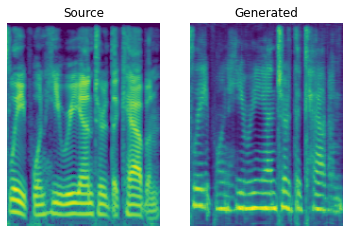

Mean D loss: 0.3812062740325928 Mean G loss: 0.7368640303611755 Mean ID loss: 0.10793932527303696
[Epoch 49/160] [Batch 0] [D loss f: 0.372568815946579 r: 0.40280067920684814] [G loss: 0.706601619720459] [ID loss: 0.1076991856098175] [LR: 0.0002]
[Epoch 49/160] [Batch 600] [D loss f: 0.382583349943161 r: 0.4066568613052368] [G loss: 0.6957074403762817] [ID loss: 0.10735542327165604] [LR: 0.0002]
[Epoch 49/160] [Batch 1200] [D loss f: 0.37516847252845764 r: 0.3962997794151306] [G loss: 0.6624574661254883] [ID loss: 0.10767366737127304] [LR: 0.0002]
Time/Batch 0.030958178095573927
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 588.61it/s, loss=0.000136, spectral_convergence=-40.4]


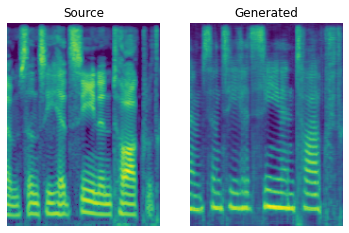

Mean D loss: 0.37869060039520264 Mean G loss: 0.6901602149009705 Mean ID loss: 0.10764108598232269
[Epoch 50/160] [Batch 0] [D loss f: 0.3785831034183502 r: 0.4049675166606903] [G loss: 0.7662755250930786] [ID loss: 0.10853350162506104] [LR: 0.0002]
[Epoch 50/160] [Batch 600] [D loss f: 0.3739878833293915 r: 0.4017379879951477] [G loss: 0.7130858302116394] [ID loss: 0.1079043298959732] [LR: 0.0002]
[Epoch 50/160] [Batch 1200] [D loss f: 0.3767279386520386 r: 0.4105890393257141] [G loss: 0.7589662671089172] [ID loss: 0.10740356147289276] [LR: 0.0002]
Time/Batch 0.030954376624448457
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 582.51it/s, loss=0.000401, spectral_convergence=-25.2]


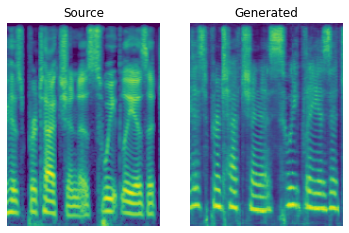

Mean D loss: 0.37420323491096497 Mean G loss: 0.7389757633209229 Mean ID loss: 0.10753188282251358
[Epoch 51/160] [Batch 0] [D loss f: 0.36472806334495544 r: 0.4127962291240692] [G loss: 0.7617246508598328] [ID loss: 0.10665952414274216] [LR: 0.0002]
[Epoch 51/160] [Batch 600] [D loss f: 0.3725181221961975 r: 0.4061068892478943] [G loss: 0.6737138628959656] [ID loss: 0.10742197930812836] [LR: 0.0002]
[Epoch 51/160] [Batch 1200] [D loss f: 0.37571361660957336 r: 0.402481347322464] [G loss: 0.7195971608161926] [ID loss: 0.1068011000752449] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030936410653330113
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 601.50it/s, loss=0.000502, spectral_convergence=-21.4]


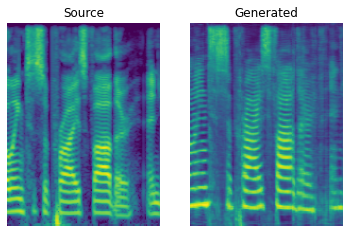

Mean D loss: 0.3737258315086365 Mean G loss: 0.6973788738250732 Mean ID loss: 0.1071685180068016
[Epoch 52/160] [Batch 0] [D loss f: 0.3744160234928131 r: 0.4086904227733612] [G loss: 0.6981877684593201] [ID loss: 0.10754264891147614] [LR: 0.0002]
[Epoch 52/160] [Batch 600] [D loss f: 0.37010326981544495 r: 0.40746524930000305] [G loss: 0.7168235182762146] [ID loss: 0.10696851462125778] [LR: 0.0002]
[Epoch 52/160] [Batch 1200] [D loss f: 0.3734574019908905 r: 0.40351349115371704] [G loss: 0.731727659702301] [ID loss: 0.10747749358415604] [LR: 0.0002]
Time/Batch 0.030949726766043337
Saving...


  5%|▌         | 100/2000 [00:00<00:03, 609.30it/s, loss=0.0428, spectral_convergence=-6.11]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 591.62it/s, loss=0.000661, spectral_convergence=-29.9]


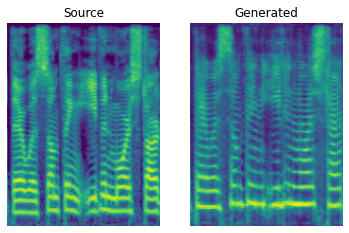

Mean D loss: 0.37225136160850525 Mean G loss: 0.727282702922821 Mean ID loss: 0.10718416422605515
[Epoch 53/160] [Batch 0] [D loss f: 0.37495243549346924 r: 0.39192816615104675] [G loss: 0.7489866018295288] [ID loss: 0.10691795498132706] [LR: 0.0002]
[Epoch 53/160] [Batch 600] [D loss f: 0.37240615487098694 r: 0.4009174108505249] [G loss: 0.7445220351219177] [ID loss: 0.10690531134605408] [LR: 0.0002]
[Epoch 53/160] [Batch 1200] [D loss f: 0.37421903014183044 r: 0.40380868315696716] [G loss: 0.746695876121521] [ID loss: 0.10695219784975052] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030930397110263796
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 594.50it/s, loss=0.00044, spectral_convergence=-22.6]


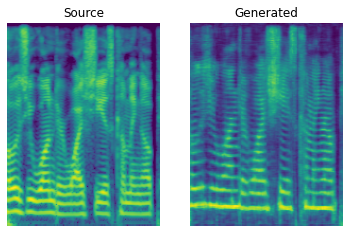

Mean D loss: 0.375650018453598 Mean G loss: 0.7482931613922119 Mean ID loss: 0.10695400834083557
[Epoch 54/160] [Batch 0] [D loss f: 0.3892333209514618 r: 0.39258748292922974] [G loss: 0.7714581489562988] [ID loss: 0.10717695206403732] [LR: 0.0002]
[Epoch 54/160] [Batch 600] [D loss f: 0.37433481216430664 r: 0.39645418524742126] [G loss: 0.7302420735359192] [ID loss: 0.10686632990837097] [LR: 0.0002]
[Epoch 54/160] [Batch 1200] [D loss f: 0.38012200593948364 r: 0.4023109972476959] [G loss: 0.7618501782417297] [ID loss: 0.10677355527877808] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03094588666066636
Saving...
(5, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 591.69it/s, loss=0.000719, spectral_convergence=-28.6]


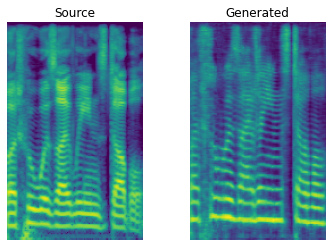

Mean D loss: 0.37675026059150696 Mean G loss: 0.7414872646331787 Mean ID loss: 0.10671906173229218
[Epoch 55/160] [Batch 0] [D loss f: 0.3752475380897522 r: 0.397765576839447] [G loss: 0.7063469886779785] [ID loss: 0.10595202445983887] [LR: 0.0002]
[Epoch 55/160] [Batch 600] [D loss f: 0.3651217222213745 r: 0.3958948850631714] [G loss: 0.6741012334823608] [ID loss: 0.10695900022983551] [LR: 0.0002]
[Epoch 55/160] [Batch 1200] [D loss f: 0.37348905205726624 r: 0.3945884108543396] [G loss: 0.7419776916503906] [ID loss: 0.106550432741642] [LR: 0.0002]
Time/Batch 0.030929841438349145
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 575.82it/s, loss=0.000259, spectral_convergence=-27.3]


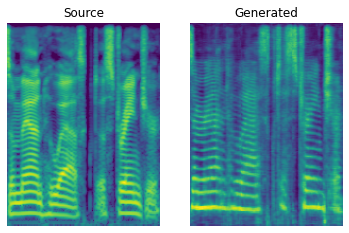

Mean D loss: 0.37078359723091125 Mean G loss: 0.7118130922317505 Mean ID loss: 0.10670285671949387
[Epoch 56/160] [Batch 0] [D loss f: 0.37938377261161804 r: 0.3914468288421631] [G loss: 0.7409545183181763] [ID loss: 0.10634637624025345] [LR: 0.0002]
[Epoch 56/160] [Batch 600] [D loss f: 0.37304478883743286 r: 0.3953212797641754] [G loss: 0.6642429828643799] [ID loss: 0.10630428045988083] [LR: 0.0002]
[Epoch 56/160] [Batch 1200] [D loss f: 0.37001174688339233 r: 0.39819443225860596] [G loss: 0.6952400803565979] [ID loss: 0.10684479773044586] [LR: 0.0002]
Time/Batch 0.03093198372499786
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 589.20it/s, loss=0.000463, spectral_convergence=-30.9]


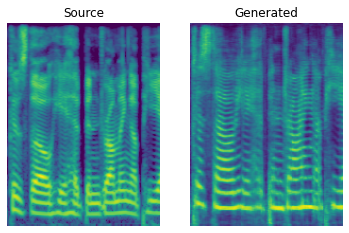

Mean D loss: 0.37123456597328186 Mean G loss: 0.6855059862136841 Mean ID loss: 0.10662733018398285
[Epoch 57/160] [Batch 0] [D loss f: 0.3687947988510132 r: 0.3999195992946625] [G loss: 0.7271767258644104] [ID loss: 0.10705485939979553] [LR: 0.0002]
[Epoch 57/160] [Batch 600] [D loss f: 0.3735126852989197 r: 0.39450377225875854] [G loss: 0.702796220779419] [ID loss: 0.10673769563436508] [LR: 0.0002]
[Epoch 57/160] [Batch 1200] [D loss f: 0.36047598719596863 r: 0.39516305923461914] [G loss: 0.7558824419975281] [ID loss: 0.10674776881933212] [LR: 0.0002]
Time/Batch 0.03094375951446756
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 587.90it/s, loss=0.000303, spectral_convergence=-30.3]


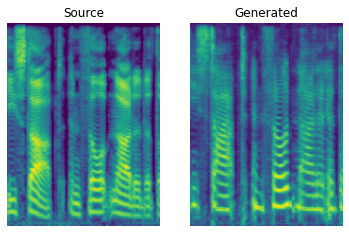

Mean D loss: 0.3645806312561035 Mean G loss: 0.72536700963974 Mean ID loss: 0.10675131529569626
[Epoch 58/160] [Batch 0] [D loss f: 0.3536764979362488 r: 0.405177503824234] [G loss: 0.689516544342041] [ID loss: 0.10677079111337662] [LR: 0.0002]
[Epoch 58/160] [Batch 600] [D loss f: 0.363760381937027 r: 0.39852848649024963] [G loss: 0.6791403889656067] [ID loss: 0.10618827491998672] [LR: 0.0002]
[Epoch 58/160] [Batch 1200] [D loss f: 0.3641543984413147 r: 0.40024033188819885] [G loss: 0.7402252554893494] [ID loss: 0.10617047548294067] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030937091625519914
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 592.32it/s, loss=0.00036, spectral_convergence=-31.5]


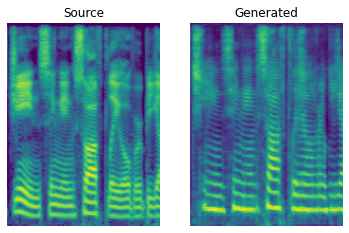

Mean D loss: 0.36450618505477905 Mean G loss: 0.7094802260398865 Mean ID loss: 0.10620416700839996
[Epoch 59/160] [Batch 0] [D loss f: 0.36270198225975037 r: 0.3950801193714142] [G loss: 0.7146554589271545] [ID loss: 0.10636299848556519] [LR: 0.0002]
[Epoch 59/160] [Batch 600] [D loss f: 0.3595951199531555 r: 0.3959110379219055] [G loss: 0.6889503598213196] [ID loss: 0.10643753409385681] [LR: 0.0002]
[Epoch 59/160] [Batch 1200] [D loss f: 0.36353984475135803 r: 0.38573017716407776] [G loss: 0.7598494291305542] [ID loss: 0.10623165220022202] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03094649697742323
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 587.72it/s, loss=0.000334, spectral_convergence=-33.9]


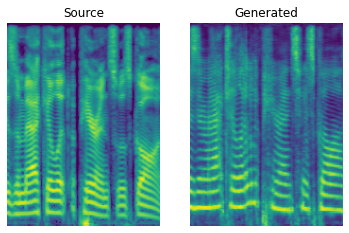

Mean D loss: 0.3619924783706665 Mean G loss: 0.7271692752838135 Mean ID loss: 0.1064116582274437
[Epoch 60/160] [Batch 0] [D loss f: 0.3666697144508362 r: 0.3927415907382965] [G loss: 0.7440662980079651] [ID loss: 0.10695132613182068] [LR: 0.0002]
[Epoch 60/160] [Batch 600] [D loss f: 0.3646189868450165 r: 0.39891916513442993] [G loss: 0.691237211227417] [ID loss: 0.10577648878097534] [LR: 0.0002]
[Epoch 60/160] [Batch 1200] [D loss f: 0.36686161160469055 r: 0.3903979957103729] [G loss: 0.7267181277275085] [ID loss: 0.10626544803380966] [LR: 0.0002]
Time/Batch 0.030950864736181107
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 592.83it/s, loss=0.000367, spectral_convergence=-29.7]


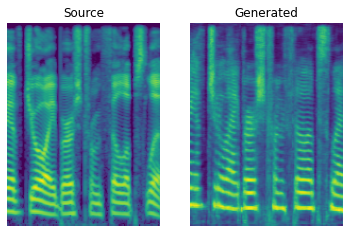

Mean D loss: 0.3664279282093048 Mean G loss: 0.7065584659576416 Mean ID loss: 0.10603104531764984
[Epoch 61/160] [Batch 0] [D loss f: 0.36913442611694336 r: 0.3919773995876312] [G loss: 0.69244784116745] [ID loss: 0.10612072795629501] [LR: 0.0002]
[Epoch 61/160] [Batch 600] [D loss f: 0.3640192151069641 r: 0.3887273073196411] [G loss: 0.7037903666496277] [ID loss: 0.10605107992887497] [LR: 0.0002]
[Epoch 61/160] [Batch 1200] [D loss f: 0.36362791061401367 r: 0.3873879909515381] [G loss: 0.6685807108879089] [ID loss: 0.10616541653871536] [LR: 0.0002]
Time/Batch 0.0309493299818387
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 588.47it/s, loss=0.000235, spectral_convergence=-37.8]


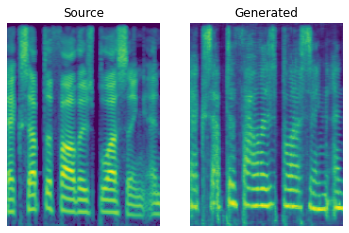

Mean D loss: 0.36295413970947266 Mean G loss: 0.6882787346839905 Mean ID loss: 0.10610835254192352
[Epoch 62/160] [Batch 0] [D loss f: 0.3587883710861206 r: 0.3900487422943115] [G loss: 0.7002196311950684] [ID loss: 0.10611792653799057] [LR: 0.0002]
[Epoch 62/160] [Batch 600] [D loss f: 0.35823673009872437 r: 0.39248305559158325] [G loss: 0.6800915002822876] [ID loss: 0.10613756626844406] [LR: 0.0002]
[Epoch 62/160] [Batch 1200] [D loss f: 0.35998398065567017 r: 0.3900330364704132] [G loss: 0.719332754611969] [ID loss: 0.10582824796438217] [LR: 0.0002]
Time/Batch 0.030942361894315176
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 594.13it/s, loss=0.000481, spectral_convergence=-26.9]


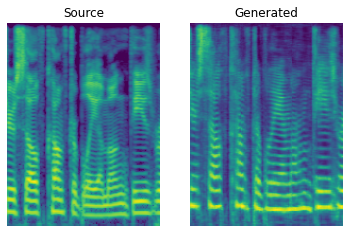

Mean D loss: 0.36072102189064026 Mean G loss: 0.7017377018928528 Mean ID loss: 0.1058996245265007
[Epoch 63/160] [Batch 0] [D loss f: 0.37193381786346436 r: 0.3773684501647949] [G loss: 0.7161202430725098] [ID loss: 0.10537255555391312] [LR: 0.0002]
[Epoch 63/160] [Batch 600] [D loss f: 0.3622293472290039 r: 0.39695218205451965] [G loss: 0.6899245977401733] [ID loss: 0.10570013523101807] [LR: 0.0002]
[Epoch 63/160] [Batch 1200] [D loss f: 0.36342307925224304 r: 0.3893829882144928] [G loss: 0.7375226616859436] [ID loss: 0.10559997707605362] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.031175491409580203
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 595.58it/s, loss=0.000242, spectral_convergence=-32.9]


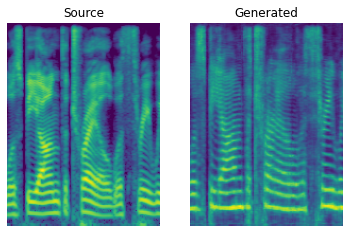

Mean D loss: 0.36266863346099854 Mean G loss: 0.7190924286842346 Mean ID loss: 0.10567725449800491
[Epoch 64/160] [Batch 0] [D loss f: 0.3608250916004181 r: 0.38982954621315] [G loss: 0.7575897574424744] [ID loss: 0.10576465725898743] [LR: 0.0002]
[Epoch 64/160] [Batch 600] [D loss f: 0.36434656381607056 r: 0.3903714418411255] [G loss: 0.7248576283454895] [ID loss: 0.10594084858894348] [LR: 0.0002]
[Epoch 64/160] [Batch 1200] [D loss f: 0.3590131998062134 r: 0.3948404788970947] [G loss: 0.7088909149169922] [ID loss: 0.10568027198314667] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.030926749131975382
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 596.84it/s, loss=0.000335, spectral_convergence=-27.2]


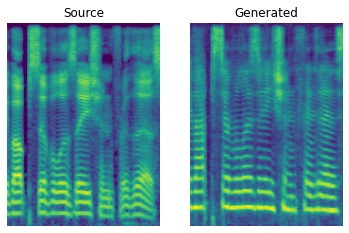

Mean D loss: 0.3614417016506195 Mean G loss: 0.7238964438438416 Mean ID loss: 0.1058238223195076
[Epoch 65/160] [Batch 0] [D loss f: 0.36132916808128357 r: 0.3762706220149994] [G loss: 0.7714762687683105] [ID loss: 0.10596869885921478] [LR: 0.0002]
[Epoch 65/160] [Batch 600] [D loss f: 0.3573690950870514 r: 0.39004647731781006] [G loss: 0.6740750074386597] [ID loss: 0.10581521689891815] [LR: 0.0002]
[Epoch 65/160] [Batch 1200] [D loss f: 0.36128705739974976 r: 0.3882172107696533] [G loss: 0.7160751819610596] [ID loss: 0.10566995292901993] [LR: 0.0002]
Time/Batch 0.030917152001039824
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 592.66it/s, loss=0.000327, spectral_convergence=-29.5]


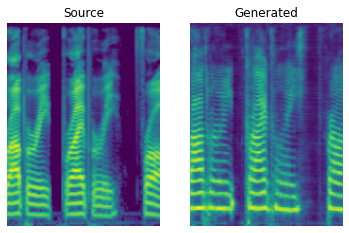

Mean D loss: 0.3600156903266907 Mean G loss: 0.6965836882591248 Mean ID loss: 0.10561690479516983
[Epoch 66/160] [Batch 0] [D loss f: 0.36243221163749695 r: 0.3871137797832489] [G loss: 0.7103978395462036] [ID loss: 0.10470651090145111] [LR: 0.0002]
[Epoch 66/160] [Batch 600] [D loss f: 0.35862481594085693 r: 0.3908117413520813] [G loss: 0.756851077079773] [ID loss: 0.10533463954925537] [LR: 0.0002]
[Epoch 66/160] [Batch 1200] [D loss f: 0.35692739486694336 r: 0.388617604970932] [G loss: 0.6833044290542603] [ID loss: 0.10563451051712036] [LR: 0.0002]
Time/Batch 0.03084914893129446
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 581.47it/s, loss=0.000269, spectral_convergence=-30]


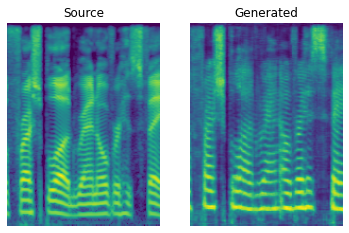

Mean D loss: 0.3572320342063904 Mean G loss: 0.722507119178772 Mean ID loss: 0.1054476797580719
[Epoch 67/160] [Batch 0] [D loss f: 0.3553376793861389 r: 0.39564192295074463] [G loss: 0.7371221780776978] [ID loss: 0.10518494248390198] [LR: 0.0002]
[Epoch 67/160] [Batch 600] [D loss f: 0.358264684677124 r: 0.3808235824108124] [G loss: 0.7985848784446716] [ID loss: 0.1055082306265831] [LR: 0.0002]
[Epoch 67/160] [Batch 1200] [D loss f: 0.3571509122848511 r: 0.3843328654766083] [G loss: 0.735861599445343] [ID loss: 0.10541922599077225] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03082152578952539
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 585.32it/s, loss=0.000337, spectral_convergence=-34.1]


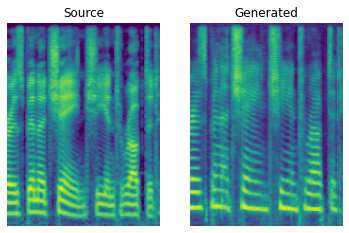

Mean D loss: 0.3556739389896393 Mean G loss: 0.7694602608680725 Mean ID loss: 0.10538123548030853
[Epoch 68/160] [Batch 0] [D loss f: 0.3405739963054657 r: 0.38011428713798523] [G loss: 0.7857813239097595] [ID loss: 0.10478944331407547] [LR: 0.0002]
[Epoch 68/160] [Batch 600] [D loss f: 0.35553890466690063 r: 0.3839063048362732] [G loss: 0.6966961026191711] [ID loss: 0.10501522570848465] [LR: 0.0002]
[Epoch 68/160] [Batch 1200] [D loss f: 0.3595062792301178 r: 0.38299697637557983] [G loss: 0.6931796073913574] [ID loss: 0.10478623956441879] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03085358786756975
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 592.34it/s, loss=0.000499, spectral_convergence=-29.1]


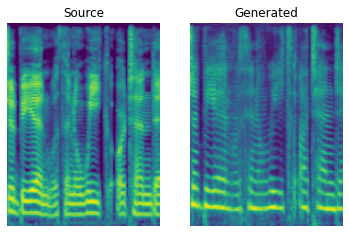

Mean D loss: 0.35687172412872314 Mean G loss: 0.6974384784698486 Mean ID loss: 0.10493606328964233
[Epoch 69/160] [Batch 0] [D loss f: 0.35354289412498474 r: 0.3718738257884979] [G loss: 0.7137611508369446] [ID loss: 0.10521765053272247] [LR: 0.0002]
[Epoch 69/160] [Batch 600] [D loss f: 0.3584914207458496 r: 0.38552430272102356] [G loss: 0.7100306153297424] [ID loss: 0.1048450917005539] [LR: 0.0002]
[Epoch 69/160] [Batch 1200] [D loss f: 0.35726210474967957 r: 0.3874342739582062] [G loss: 0.7315013408660889] [ID loss: 0.1043354943394661] [LR: 0.0002]
Time/Batch 0.030879846976621307
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 588.71it/s, loss=0.000179, spectral_convergence=-38.1]


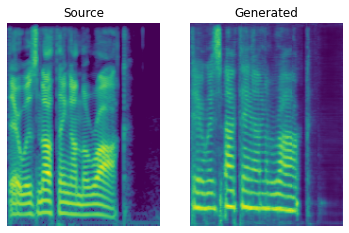

Mean D loss: 0.35938113927841187 Mean G loss: 0.7353413105010986 Mean ID loss: 0.10460774600505829
[Epoch 70/160] [Batch 0] [D loss f: 0.36830630898475647 r: 0.3824485242366791] [G loss: 0.8397865295410156] [ID loss: 0.10469057410955429] [LR: 0.0002]
[Epoch 70/160] [Batch 600] [D loss f: 0.35181885957717896 r: 0.38105037808418274] [G loss: 0.703671932220459] [ID loss: 0.10482984036207199] [LR: 0.0002]
[Epoch 70/160] [Batch 1200] [D loss f: 0.3587607145309448 r: 0.38070040941238403] [G loss: 0.7184268236160278] [ID loss: 0.10496677458286285] [LR: 0.0002]
Time/Batch 0.03083805881277488
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 596.97it/s, loss=0.000168, spectral_convergence=-38.6]


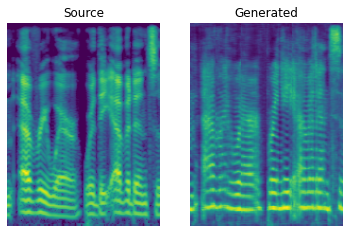

Mean D loss: 0.354992538690567 Mean G loss: 0.7146373391151428 Mean ID loss: 0.10490414500236511
[Epoch 71/160] [Batch 0] [D loss f: 0.3541871905326843 r: 0.39237672090530396] [G loss: 0.7378308773040771] [ID loss: 0.10495451092720032] [LR: 0.0002]
[Epoch 71/160] [Batch 600] [D loss f: 0.35418033599853516 r: 0.38404473662376404] [G loss: 0.7094536423683167] [ID loss: 0.10446905344724655] [LR: 0.0002]
[Epoch 71/160] [Batch 1200] [D loss f: 0.35568419098854065 r: 0.38293004035949707] [G loss: 0.737609326839447] [ID loss: 0.10448414087295532] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03085407601655835
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 594.43it/s, loss=0.000459, spectral_convergence=-38]


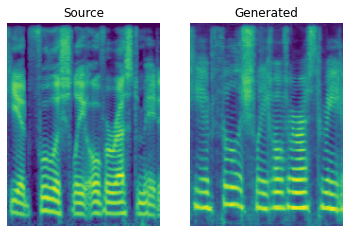

Mean D loss: 0.3542459011077881 Mean G loss: 0.7243243455886841 Mean ID loss: 0.10455923527479172
[Epoch 72/160] [Batch 0] [D loss f: 0.34733471274375916 r: 0.38823968172073364] [G loss: 0.7328565716743469] [ID loss: 0.10514172166585922] [LR: 0.0002]
[Epoch 72/160] [Batch 600] [D loss f: 0.35121408104896545 r: 0.3825497329235077] [G loss: 0.6761136651039124] [ID loss: 0.10460211336612701] [LR: 0.0002]
[Epoch 72/160] [Batch 1200] [D loss f: 0.3563586175441742 r: 0.3810991048812866] [G loss: 0.7252598404884338] [ID loss: 0.10433997958898544] [LR: 0.0002]
Time/Batch 0.03086198959907476
Saving...


  4%|▍         | 90/2000 [00:00<00:03, 551.43it/s, loss=0.00703, spectral_convergence=-9.67]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 590.58it/s, loss=0.000243, spectral_convergence=-31.3]


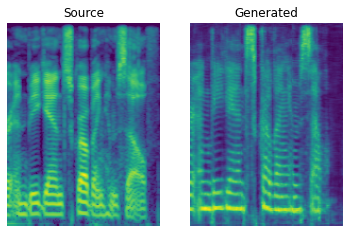

Mean D loss: 0.35442760586738586 Mean G loss: 0.7016216516494751 Mean ID loss: 0.10446526110172272
[Epoch 73/160] [Batch 0] [D loss f: 0.3622302711009979 r: 0.38406819105148315] [G loss: 0.7040388584136963] [ID loss: 0.10440827161073685] [LR: 0.0002]
[Epoch 73/160] [Batch 600] [D loss f: 0.354785293340683 r: 0.3796413838863373] [G loss: 0.7344809770584106] [ID loss: 0.1044529378414154] [LR: 0.0002]
[Epoch 73/160] [Batch 1200] [D loss f: 0.3521402180194855 r: 0.38544926047325134] [G loss: 0.6992021799087524] [ID loss: 0.10469312965869904] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03082708303075637
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 565.81it/s, loss=0.000218, spectral_convergence=-27]


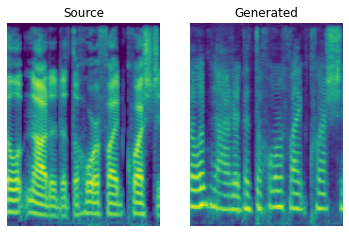

Mean D loss: 0.3540315628051758 Mean G loss: 0.7292642593383789 Mean ID loss: 0.10458377003669739
[Epoch 74/160] [Batch 0] [D loss f: 0.3567500114440918 r: 0.380267858505249] [G loss: 0.8180111646652222] [ID loss: 0.10466786473989487] [LR: 0.0002]
[Epoch 74/160] [Batch 600] [D loss f: 0.35680311918258667 r: 0.38338378071784973] [G loss: 0.716474175453186] [ID loss: 0.10403439402580261] [LR: 0.0002]
[Epoch 74/160] [Batch 1200] [D loss f: 0.3464778661727905 r: 0.38073018193244934] [G loss: 0.7338340282440186] [ID loss: 0.10383742302656174] [LR: 0.0002]
Time/Batch 0.0308560856937492
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 589.36it/s, loss=0.000245, spectral_convergence=-28.8]


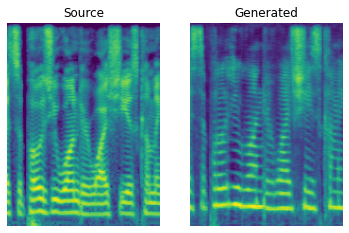

Mean D loss: 0.3531409204006195 Mean G loss: 0.7400035262107849 Mean ID loss: 0.10397951304912567
[Epoch 75/160] [Batch 0] [D loss f: 0.3625085949897766 r: 0.3728178143501282] [G loss: 0.845550537109375] [ID loss: 0.10427838563919067] [LR: 0.0002]
[Epoch 75/160] [Batch 600] [D loss f: 0.3522546887397766 r: 0.37720227241516113] [G loss: 0.7302020192146301] [ID loss: 0.10439970344305038] [LR: 0.0002]
[Epoch 75/160] [Batch 1200] [D loss f: 0.3457523584365845 r: 0.38079461455345154] [G loss: 0.6915509104728699] [ID loss: 0.10410656034946442] [LR: 0.0002]
Time/Batch 0.0308608220441498
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 593.68it/s, loss=0.000255, spectral_convergence=-27.7]


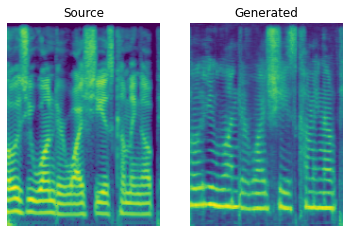

Mean D loss: 0.34837576746940613 Mean G loss: 0.7142325639724731 Mean ID loss: 0.10423842817544937
[Epoch 76/160] [Batch 0] [D loss f: 0.34328731894493103 r: 0.3813144564628601] [G loss: 0.73869788646698] [ID loss: 0.10414927452802658] [LR: 0.0002]
[Epoch 76/160] [Batch 600] [D loss f: 0.3414607346057892 r: 0.3779312074184418] [G loss: 0.7205280065536499] [ID loss: 0.10403093695640564] [LR: 0.0002]
[Epoch 76/160] [Batch 1200] [D loss f: 0.34594064950942993 r: 0.37670812010765076] [G loss: 0.7226688265800476] [ID loss: 0.10386507958173752] [LR: 0.0002]


  0%|          | 0/2000 [00:00<?, ?it/s]

Time/Batch 0.03085310789790467
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 595.35it/s, loss=0.000235, spectral_convergence=-41.9]


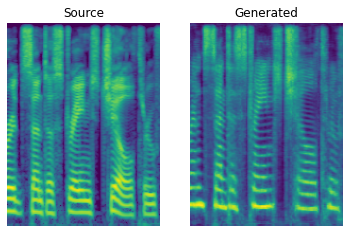

Mean D loss: 0.343857079744339 Mean G loss: 0.7191845774650574 Mean ID loss: 0.10396331548690796
[Epoch 77/160] [Batch 0] [D loss f: 0.3458712697029114 r: 0.3776104152202606] [G loss: 0.7006100416183472] [ID loss: 0.10407032072544098] [LR: 0.0002]
[Epoch 77/160] [Batch 600] [D loss f: 0.3465989828109741 r: 0.3733838200569153] [G loss: 0.6734703183174133] [ID loss: 0.10422220826148987] [LR: 0.0002]
[Epoch 77/160] [Batch 1200] [D loss f: 0.3501041531562805 r: 0.377792090177536] [G loss: 0.7560029029846191] [ID loss: 0.10402528196573257] [LR: 0.0002]
Time/Batch 0.0308507061352695
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 594.26it/s, loss=0.000101, spectral_convergence=-35.4]


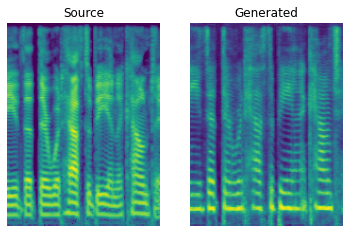

Mean D loss: 0.34807899594306946 Mean G loss: 0.7039149403572083 Mean ID loss: 0.1041361466050148
[Epoch 78/160] [Batch 0] [D loss f: 0.3477817475795746 r: 0.381098210811615] [G loss: 0.6263871788978577] [ID loss: 0.10423508286476135] [LR: 0.0002]
[Epoch 78/160] [Batch 600] [D loss f: 0.3441334366798401 r: 0.3801296651363373] [G loss: 0.6805500388145447] [ID loss: 0.10426151752471924] [LR: 0.0002]
[Epoch 78/160] [Batch 1200] [D loss f: 0.3461589813232422 r: 0.37391337752342224] [G loss: 0.7219879627227783] [ID loss: 0.10405758023262024] [LR: 0.0002]
Time/Batch 0.030878914359712253
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:03<00:00, 585.35it/s, loss=0.000252, spectral_convergence=-35.7]


Buffered data was truncated after reaching the output size limit.

In [ ]:
#Training

#n_save = how many epochs between each saving and displaying of results
#gupt = how many discriminator updates for generator+siamese update

train(160, batch_size=bs, lr=0.0002, n_save=1, gupt=3)

In [1]:
#After Training, use these functions to convert data with the generator and save the results

#Assembling generated Spectrogram chunks into final Spectrogram
def specass(a,spec):
  but=False
  con = np.array([])
  nim = a.shape[0]
  for i in range(nim-1):
    im = a[i]
    im = np.squeeze(im)
    if not but:
      con=im
      but=True
    else:
      con = np.concatenate((con,im), axis=1)
  diff = spec.shape[1]-(nim*shape)
  a = np.squeeze(a)
  con = np.concatenate((con,a[-1,:,-diff:]), axis=1)
  return np.squeeze(con)

#Splitting input spectrogram into different chunks to feed to the generator
def chopspec(spec):
  dsa=[]
  for i in range(spec.shape[1]//shape):
    im = spec[:,i*shape:i*shape+shape]
    im = np.reshape(im, (im.shape[0],im.shape[1],1))
    dsa.append(im)
  imlast = spec[:,-shape:]
  imlast = np.reshape(imlast, (imlast.shape[0],imlast.shape[1],1))
  dsa.append(imlast)
  return np.array(dsa, dtype=np.float32)

#Converting from source Spectrogram to target Spectrogram
def towave(spec, name, path, show=False):
  specarr = chopspec(spec)
  print(specarr.shape)
  a = specarr
  print('Generating...')
  ab = gen(a, training=False)
  print('Assembling and Converting...')
  a = specass(a,spec)
  ab = specass(ab,spec)
  awv = deprep(a)
  abwv = deprep(ab)
  print('Saving...')
  pathfin = f'{path}/{name}'
  os.mkdir(pathfin)
  sf.write(pathfin+'/AB.wav', abwv, sr)
  sf.write(pathfin+'/A.wav', awv, sr)
  print('Saved WAV!')
  IPython.display.display(IPython.display.Audio(np.squeeze(abwv), rate=sr))
  IPython.display.display(IPython.display.Audio(np.squeeze(awv), rate=sr))
  if show:
    fig, axs = plt.subplots(ncols=2)
    axs[0].imshow(np.flip(a, -2), cmap=None)
    axs[0].axis('off')
    axs[0].set_title('Source')
    axs[1].imshow(np.flip(ab, -2), cmap=None)
    axs[1].axis('off')
    axs[1].set_title('Generated')
    plt.show()
  return abwv

In [2]:
wv=audio_array('/content/drive/MyDrive/nlp-project/tensorflow-speech-recognition-challenge/playground/audio/bed')

NameError: ignored

In [3]:
# wv=audio_array('/content/drive/MyDrive/nlp-project/tensorflow-speech-recognition-challenge/train/audio/bed')
print(wv.shape)
speca = prep(wv[1])                                                    #Waveform to Spectrogram

plt.figure(figsize=(50,1))                                          #Show Spectrogram
plt.imshow(np.flip(speca, axis=0), cmap=None)
plt.axis('off')
plt.show()
from datetime import datetime

name = datetime.now().strftime("%Y%m%d%H%M%S") 
abwv = towave(speca, name=name, path='/content/drive/MyDrive/nlp-project/output')           #Convert and save wav

NameError: ignored

In [ ]:
wv=audio_array('/content/drive/MyDrive/nlp-project/tensorflow-speech-recognition-challenge/train/audio/bed')
print(wv.shape)
speca = prep(wv[1])                                                    #Waveform to Spectrogram

plt.figure(figsize=(50,1))                                          #Show Spectrogram
plt.imshow(np.flip(speca, axis=0), cmap=None)
plt.axis('off')
plt.show()
from datetime import datetime

name = datetime.now().strftime("%Y%m%d%H%M%S") 
abwv = towave(speca, name=name, path='/content/drive/MyDrive/nlp-project/output')           #Convert and save wav